# Constant v_t - pristine update all levels - 68

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
from matplotlib.pylab import *
from IPython import display
rcParams['figure.figsize'] = (12,8)
rcParams['font.size'] = 18
import logging

In [2]:
import pynbody
import pynbody.plot.sph as sph
import mmap
import gc
import sys, os, glob, pickle
pynbody.ramses.multiprocess_num = 4
pynbody.config['number_of_threads'] = 32

In [3]:
import matplotlib.pyplot as plt 

In [4]:
gc.collect()

1007

In [5]:
s = pynbody.load('output_00068')
#s['pos']
s['pos'] -= 0.5
s.physical_units();

INFO:pynbody:Loading using backend <class 'pynbody.snapshot.ramses.RamsesSnap'>
INFO:pynbody.snapshot.ramses:Loading hydro files
INFO:pynbody.snapshot.ramses:Done
INFO:pynbody.snapshot.ramses:Loading data from CPU 1
INFO:pynbody.snapshot.ramses:Loading data from CPU 65
INFO:pynbody.snapshot.ramses:Loading data from CPU 129
INFO:pynbody.snapshot.ramses:Loading data from CPU 193
INFO:pynbody.snapshot.ramses:Loading data from CPU 2
INFO:pynbody.snapshot.ramses:Loading data from CPU 66
INFO:pynbody.snapshot.ramses:Loading data from CPU 130
INFO:pynbody.snapshot.ramses:Loading data from CPU 194
INFO:pynbody.snapshot.ramses:Loading data from CPU 3
INFO:pynbody.snapshot.ramses:Loading data from CPU 67
INFO:pynbody.snapshot.ramses:Loading data from CPU 131
INFO:pynbody.snapshot.ramses:Loading data from CPU 195
INFO:pynbody.snapshot.ramses:Loading data from CPU 4
INFO:pynbody.snapshot.ramses:Loading data from CPU 68
INFO:pynbody.snapshot.ramses:Loading data from CPU 132
INFO:pynbody.snapshot.ra

In [6]:
z = 1/s.properties['a']-1
print "Redshift =",z
boxsizestring = "%.2f" % s.properties['boxsize'].in_units('kpc')
boxsizestring += " kpc"
print boxsizestring

Redshift = 10.4028294908
369.87 kpc


In [7]:
# just once per snap
s.derivable_keys()[1:5]
pynbody.analysis.ramses_util.get_tform(s,"/Users/earnric/bin/part2birth");

In [8]:
s.properties

{'a': 0.087697531634816,
 'boxsize': Unit("3.70e+02 kpc"),
 'h': 0.71,
 'omegaL0': 0.732999980449677,
 'omegaM0': 0.266999989748001,
 'time': Unit("4.72e-01 kpc s km**-1")}

In [9]:
s.g['metal'][s.g['metal']<2e-7] = 0.0
s.g['pzf'][s.g['pzf']<2e-7] = 0.0
s.g['pgf'][s.g['pgf']>1.0 - 1e-7] = 1.0
s.g['pgf'][s.g['pgf']<0.0] = 0.0

s.s['metal'][s.s['metal']<2e-7] = 0.0
s.s['pzf'][s.s['pzf']<2e-7] = 0.0
s.s['ppf'][s.s['ppf']>1.0 - 1e-7] = 1.0
s.s['ppf'][s.s['ppf']<0.0] = 0.0

(1e-07, 1)

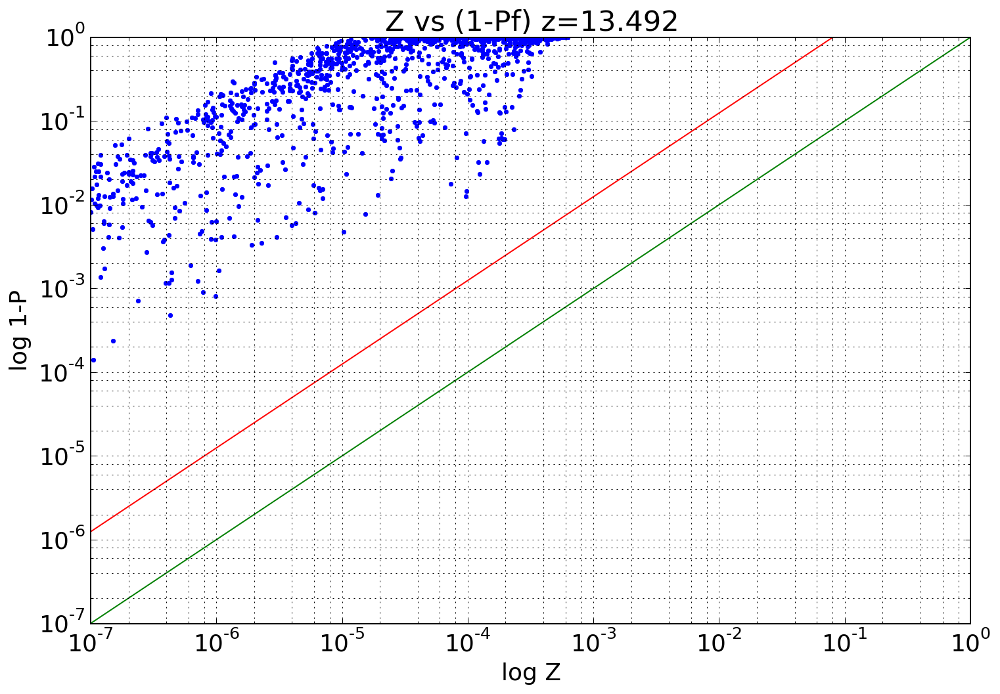

In [10]:
linex=(1e-7,1)
liney=(1e-7*12.45144,12.45144) # Y coords of line with slope 12.4514423189731
plt.loglog(s.g['metal'],1.0-s.g['pgf'],'.',linex,linex,linex,liney)
plt.title("Z vs (1-Pf) z=%.3f"%z)
plt.grid(True, which="both")
axes().set_xlabel("log Z")
axes().set_ylabel("log 1-P")
plt.ylim(1e-7, 1)
plt.xlim(1e-7, 1)

In [73]:
    x,y,zz = - s.s['pos'][1] # Get the last one
    print "Star offset ", x,y,zz
    bs = float(s.properties['boxsize'])
    print "Boxsize ", bs
    print "Boxsize native ", s.properties['boxsize']
    sbox = 40.0
    if (abs(x) > bs/2.0 - sbox):
        x = np.sign(x) * (bs/2.0 - sbox)
    if (abs(y) > bs/2.0 - sbox):
        y = np.sign(y) * (bs/2.0 - sbox)
    if (abs(zz) > bs/2.0 - sbox):
        zz = np.sign(zz) * (bs/2.0 - sbox)
    
    # Create the base name for plots
    plotfile = "3Mpc_z%.1lf"%z
    coords2= [x,y,zz] # NOTE WE ARE TRANSLATING... May not be centered on sp
    smallbox= str(sbox) + ' kpc'
    print smallbox
    print "Center view: ", coords2

Star offset  93.2497762351 55.099832832 96.3727040843
Boxsize  369.870836397
Boxsize native  3.70e+02 kpc
40.0 kpc
Center view:  [93.249776235088007, 55.099832831960413, 96.372704084317903]


In [75]:
gc.collect()

0

In [74]:
rx,ry,rz = -1 * np.array([x,y,zz])
snBlast = s[pynbody.filt.Cuboid(str((rx-sbox/2.0)) +" kpc", str((ry-sbox/2.0)) +" kpc",str((rz-sbox/2.0)) + " kpc",
            str((rx+sbox/2.0)) +" kpc", str((ry+sbox/2.0)) +" kpc",str((rz+sbox/2.0)) + " kpc")]
snBlast.g['velMag']=sqrt(snBlast.g['vx']**2+snBlast.g['vy']**2+snBlast.g['vz']**2)
print str((rx-sbox/2.0)) +" kpc", str((ry-sbox/2.0)) +" kpc",str((rz-sbox/2.0)) + " kpc"
print str((rx+sbox/2.0)) +" kpc", str((ry+sbox/2.0)) +" kpc",str((rz+sbox/2.0)) + " kpc"
print coords2

-113.249776235 kpc -75.099832832 kpc -116.372704084 kpc
-73.2497762351 kpc -35.099832832 kpc -76.3727040843 kpc
[93.249776235088007, 55.099832831960413, 96.372704084317903]


In [51]:
snBlast.g['pol']=1.0-snBlast.g['pgf']

In [72]:
snBlast.g['metal'][snBlast.g['metal']>0.0]

SimArray([], dtype=float64)

In [57]:
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="nipy_spectral", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z-z = %.1lf std" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="nipy_spectral", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF-z = %.1lf std" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Polluted - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pol",width=smallbox,cmap="nipy_spectral", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Polluted-z = %.1lf std" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="nipy_spectral", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t-z = %.1lf std" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams - z = %.1lf" % z + "\nSlice @ %s" % str(coords2)
    sph.velocity_image(s.g,width=smallbox,cmap="nipy_spectral", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams-z = %.1lf std" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


ValueError: Failed to make a sensible logarithmic image. This probably means there are no particles in the view.

In [34]:
x,y,z = - s.s['pos'][len(s.s)-1] # Get the last one
bs = float(s.properties['boxsize'])
if (abs(x) > bs/2.0 - 3.0):
    x = np.sign(x) * (bs/2.0 - 3.0)
if (abs(y) > bs/2.0 - 3.0):
    y = np.sign(y) * (bs/2.0 - 3.0)
if (abs(zz) > bs/2.0 - 3.0):
    zz = np.sign(zz) * (bs/2.0 - 3.0)


In [35]:
    plotfile = "300kpc_z%.1lf"%z
    coords2= [x,y,z] # NOTE WE ARE TRANSLATING... Note quite center, but the SN is at the edge of the box!
    smallbox='3.0 kpc'

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.snapshot:Deriving array mass
INFO:pynbody.sph:Rendering image on 32 threads...


Plot v_t...


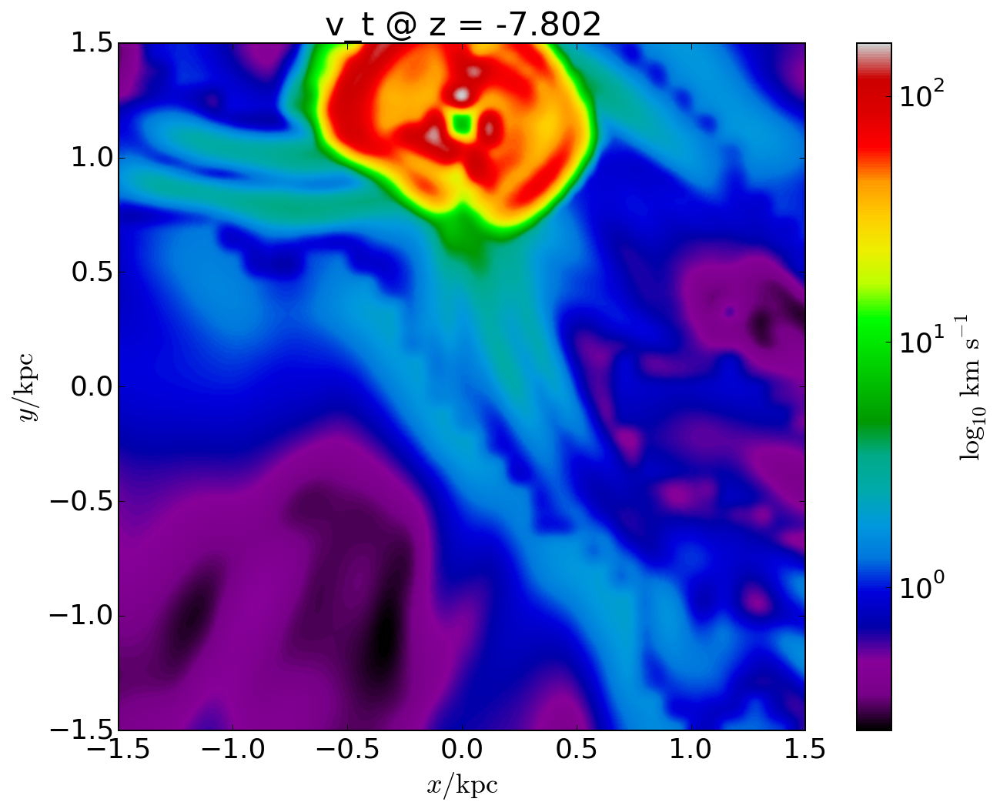

In [38]:
with pynbody.transformation.translate(snBlast,coords2):
    print "Plot v_t..."
    titleStr = "v_t @ z = %.3lf" % z
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="nipy_spectral", denoise=True ,av_z=False, log=True, 
                  approximate_fast=False,title=titleStr,filename=plotfile+'.vt.old.png'); #vmin=0.006, vmax=1.0,

In [ ]:
Star offset  -47.6415744262 67.6838701672 178.095285011

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.snapshot:Deriving array mass
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


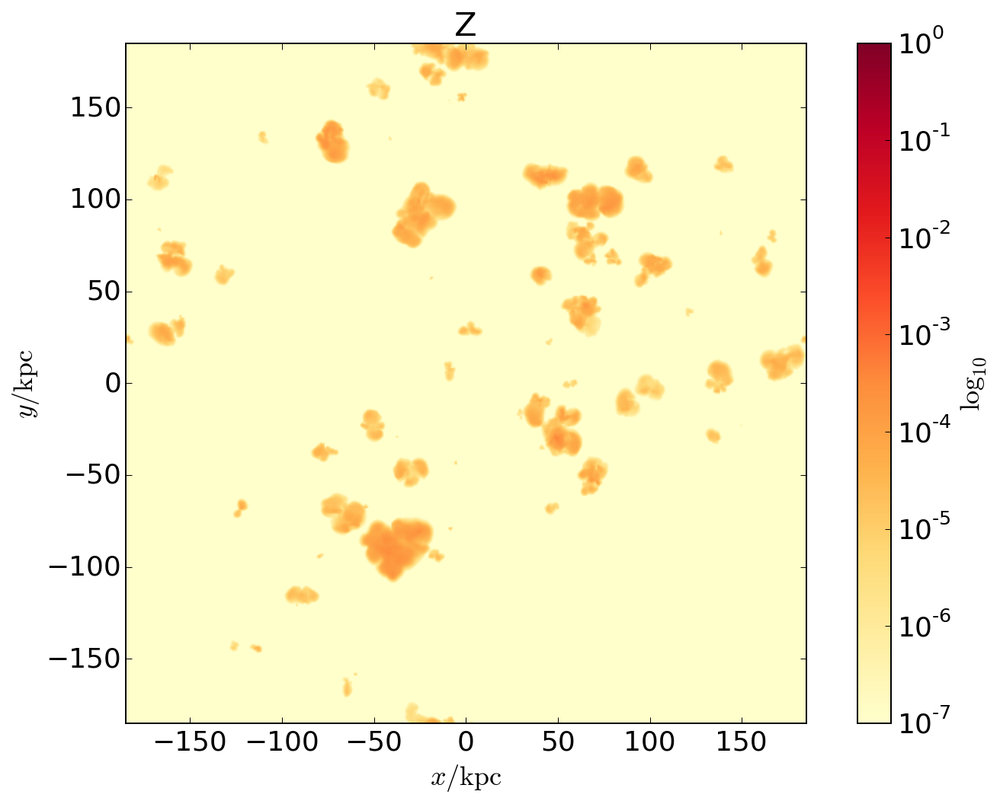

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


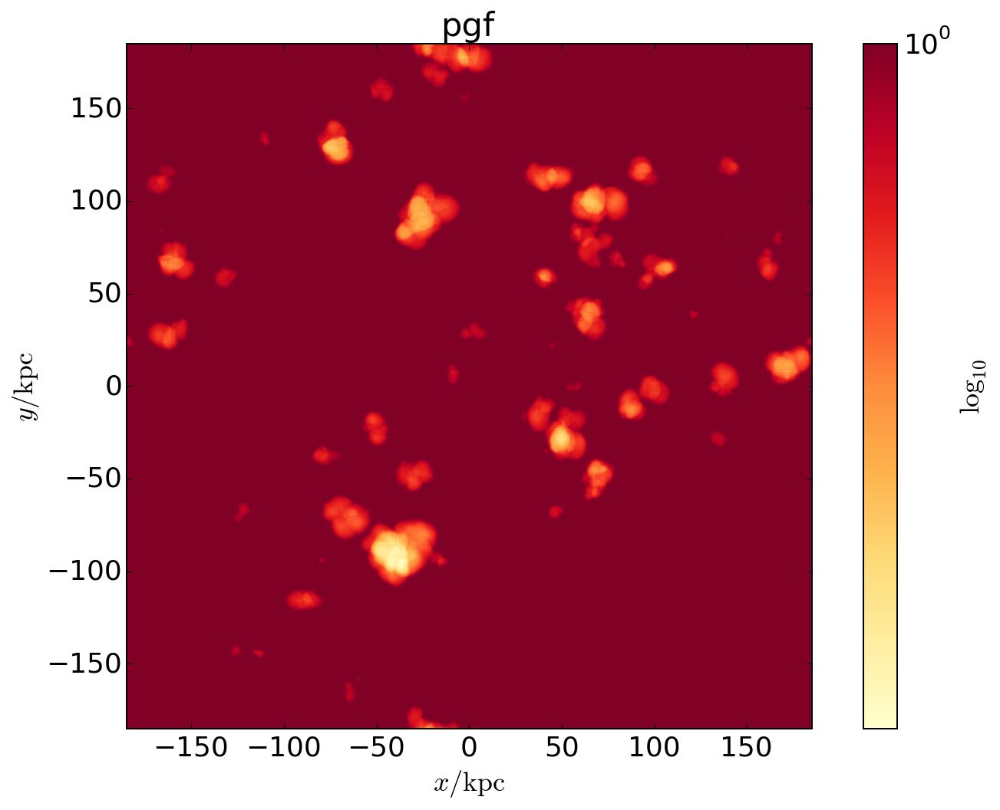

In [10]:
sph.image(s.g,qty="metal",width=boxsizestring,cmap="YlOrRd", denoise=True ,av_z=True, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title="Z"); #vmin=0.006, vmax=1.0,
plt.show()
sph.image(s.g,qty="pgf",width=boxsizestring,cmap="YlOrRd", denoise=True ,av_z=True, log=True,
              approximate_fast=False,title="pgf"); #vmin=0.006, vmax=1.0,
plt.show()

In [11]:
s.s['pos']

SimArray([[ -9.39381394,  -5.51457135,  12.96952271],
       [ -1.69480943,  17.09167197,  10.15964148],
       [ -2.19852564,  18.42625401,  12.37384173]], 'kpc')

In [12]:
snBlast = s[pynbody.filt.Cuboid("-6.0 kpc", "10.0 kpc","7.0 kpc",
                                 "4.0 kpc", "18.46 kpc", "16.6 kpc")]

In [13]:
# This is right at the blast ... why only a few points > 20 km/sec!
# Look at pymses output.
snBlast.g['tv'][snBlast.g['tv']>20]

SimArray([ 20.76055802,  20.1067892 ,  21.06231679,  25.30034276,
        20.98863258,  24.8390387 ,  20.17171326,  21.5335847 ], 'km s**-1')

In [14]:
len(snBlast.g['tv'][snBlast.g['tv']>75]),len(snBlast.g)

(0, 478480)

In [15]:
snBlast.g['velMag']=sqrt(snBlast.g['vx']**2+snBlast.g['vy']**2+snBlast.g['vz']**2)

In [16]:
s.g['velMag'].max()

SimArray(26.4883340252488, 'km s**-1')

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


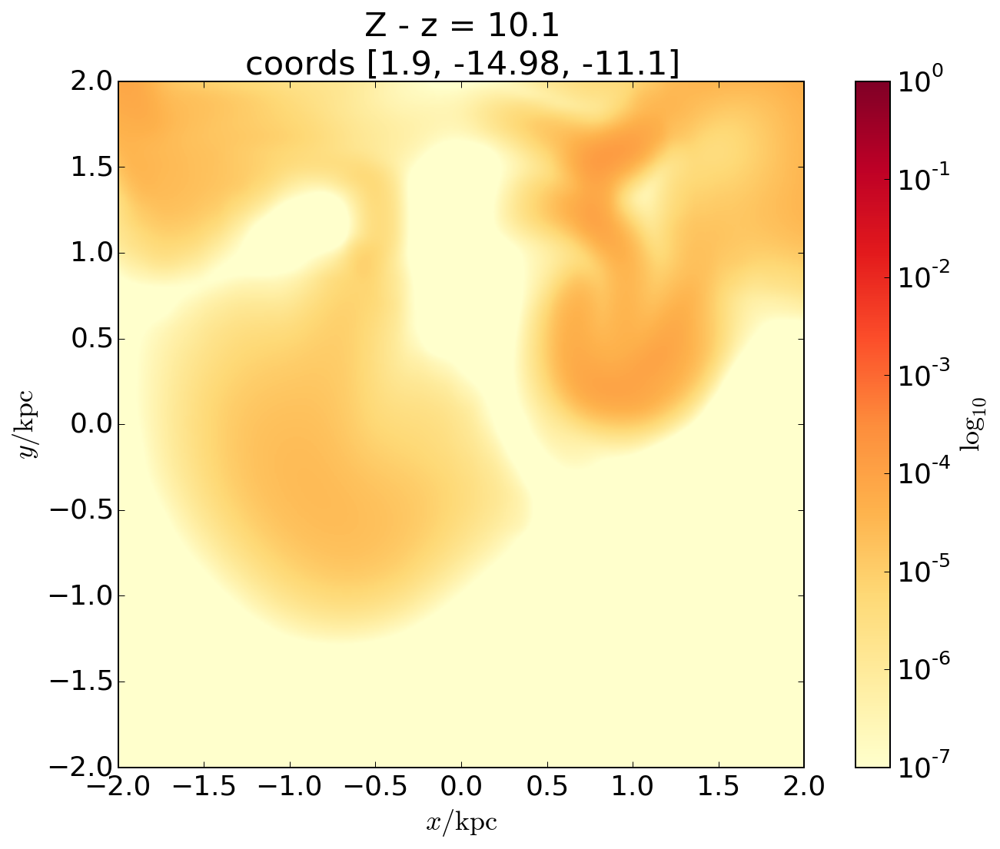

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


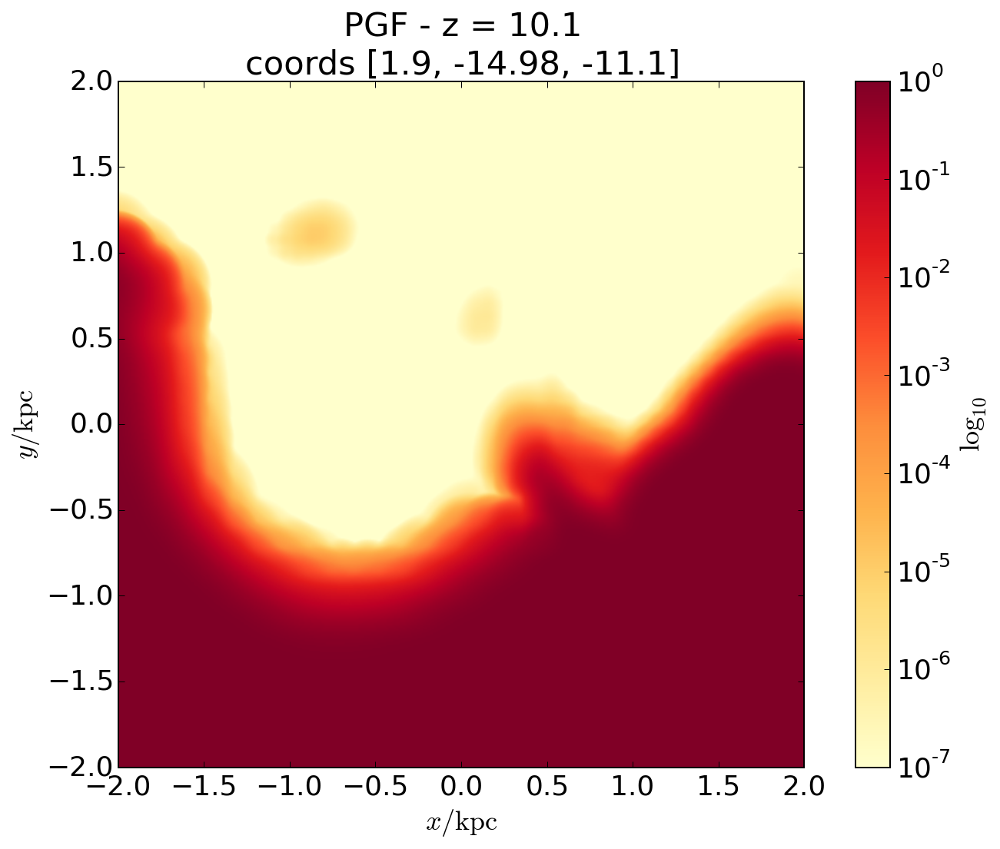

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


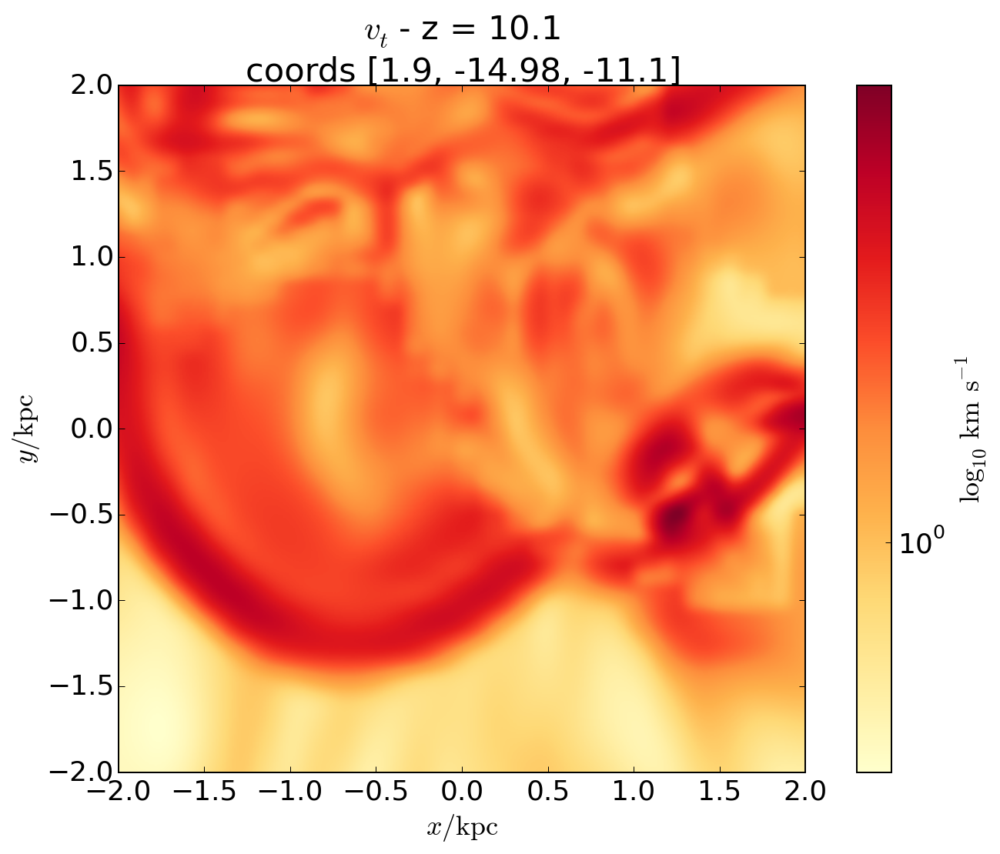

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


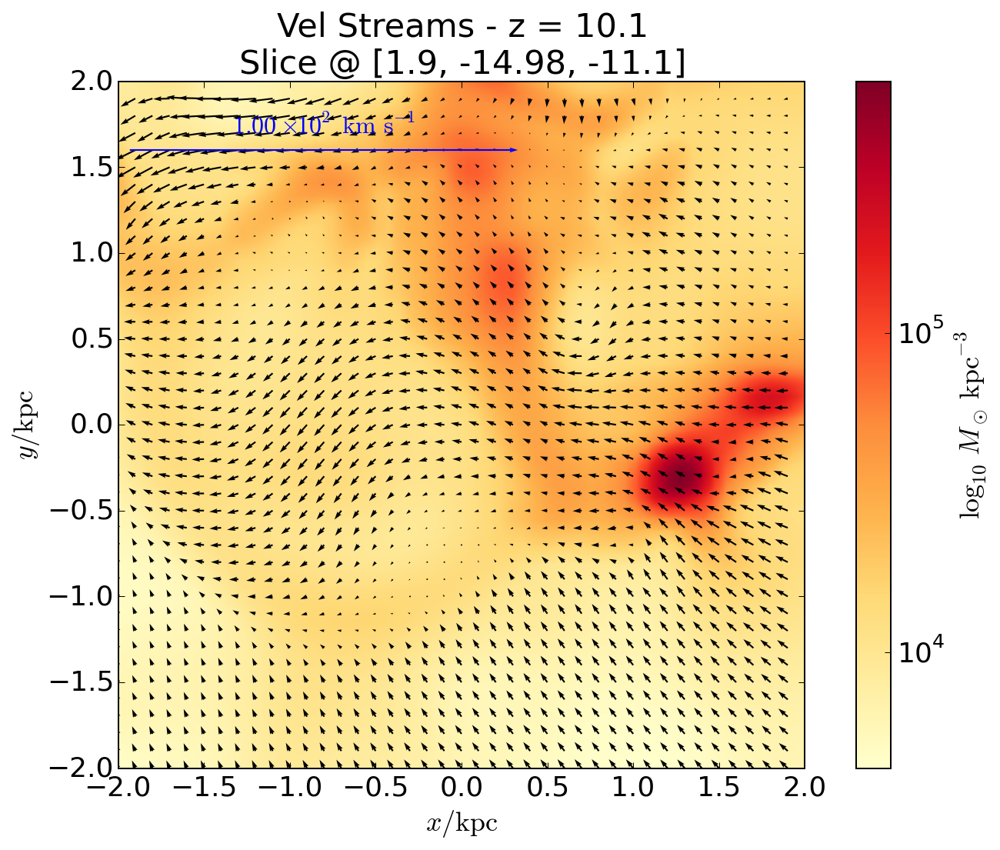

In [17]:
coords2= [1.9,-14.98,-11.1] # NOTE WE ARE TRANSLATING... Note quite center, but the SN is at the edge of the box!
smallbox='4.0 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams - z = %.1lf" % z + "\nSlice @ %s" % str(coords2)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


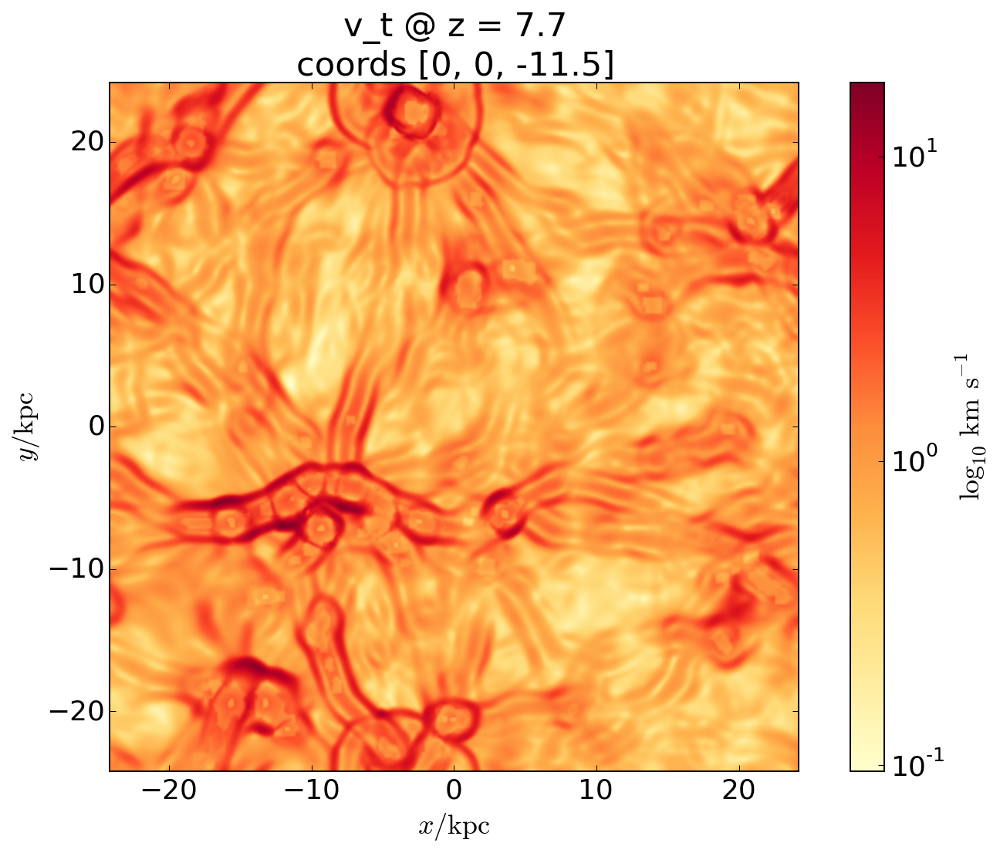

In [24]:
with pynbody.transformation.translate(s,[0,0,-11.5]):
    titleStr = "v_t @ z = %.1lf" % z  + "\ncoords %s"%str([0,0,-11.5])
    sph.image(s.g,qty="tv",width=boxsizestring,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
                  approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


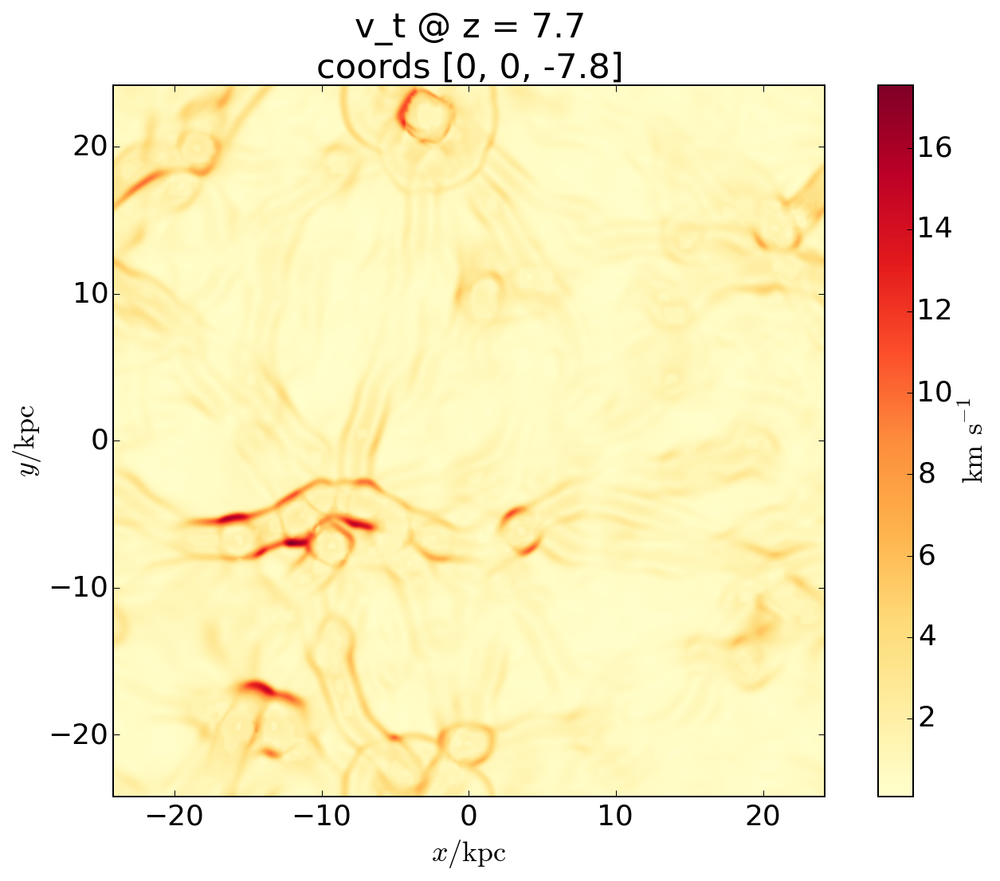

In [25]:
with pynbody.transformation.translate(s,[0,0,-11.5]):
    titleStr = "v_t @ z = %.1lf" % z + "\ncoords %s" % str([0,0,-7.8])
    sph.image(s.g,qty="tv",width=boxsizestring,cmap="YlOrRd", denoise=True ,av_z=False, log=False, 
                  approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


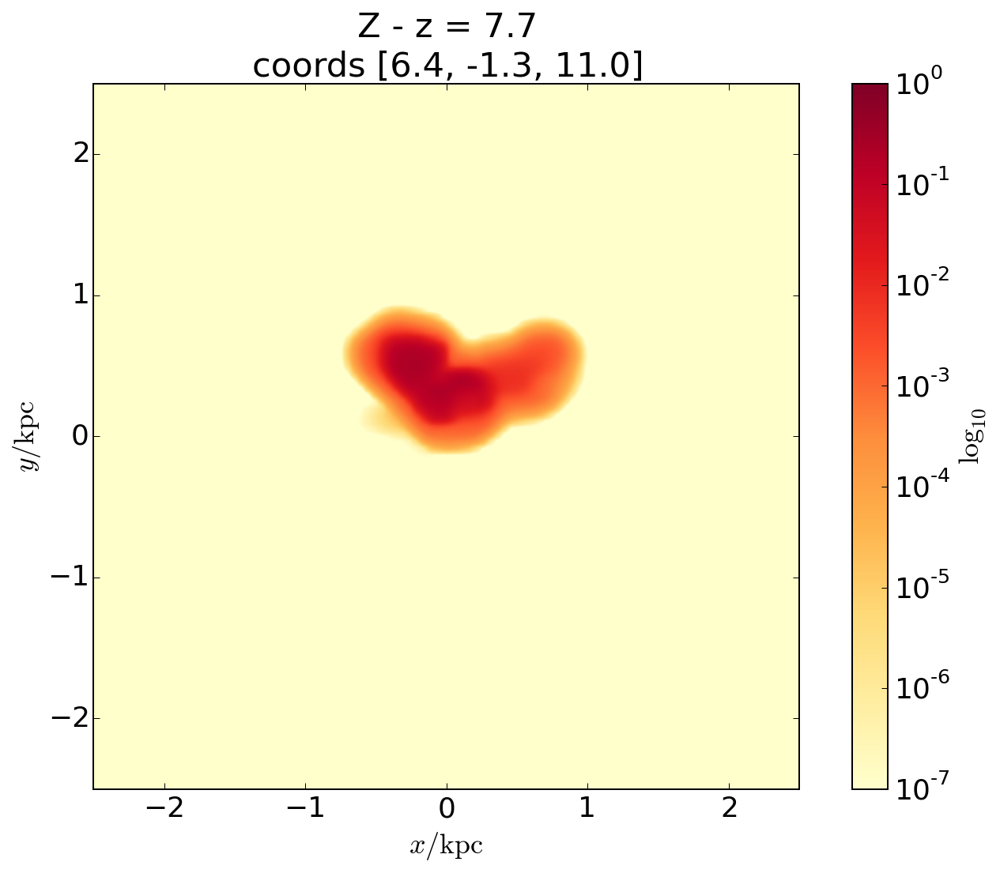

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


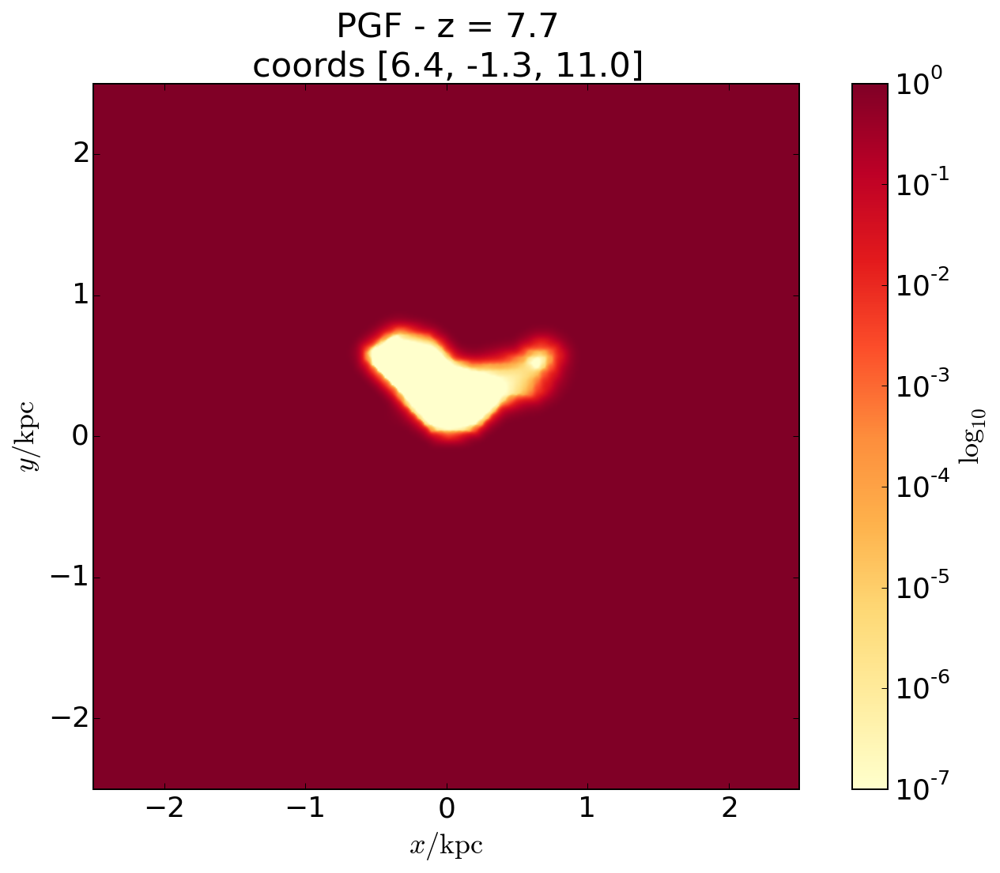

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


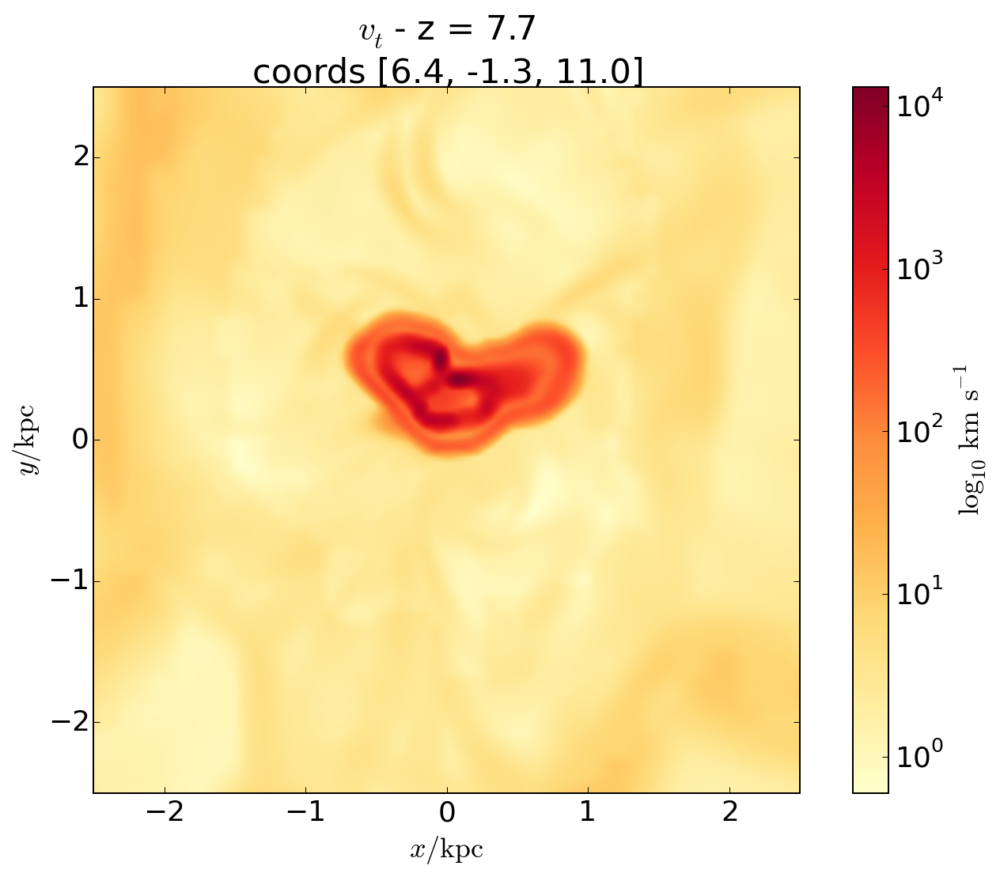

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


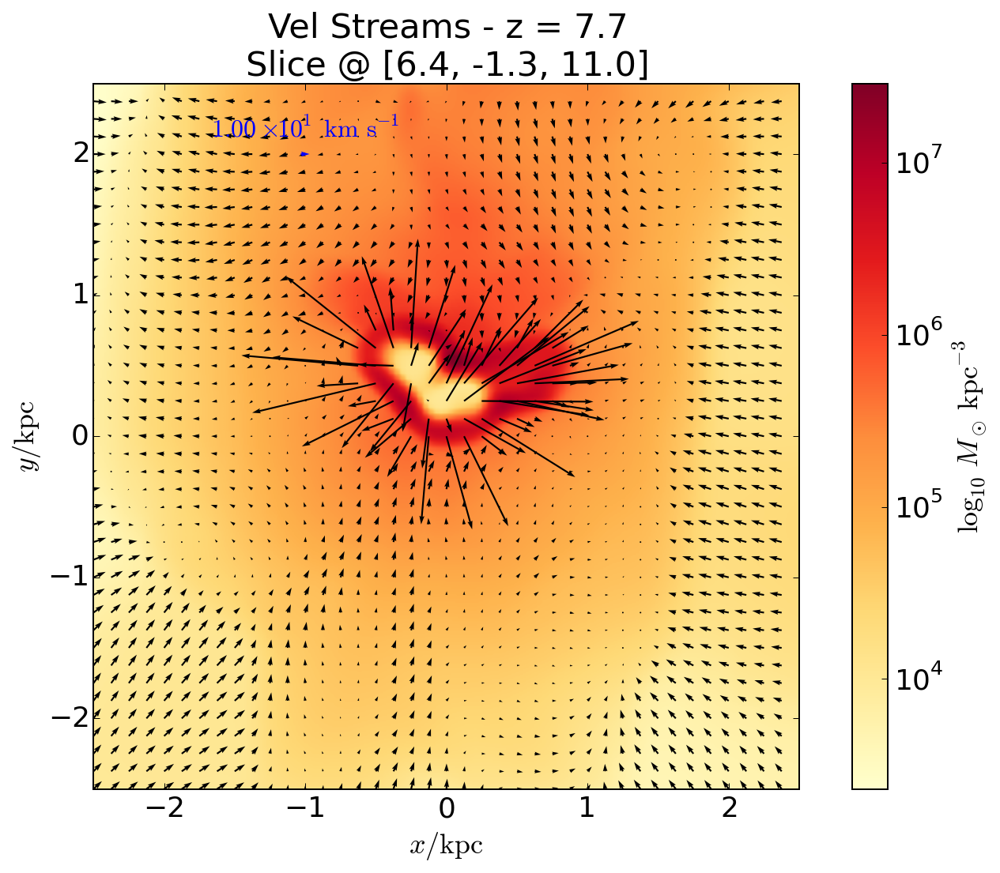

In [27]:
coords2= [6.4,-1.3,11.0] # NOTE WE ARE TRANSLATING... Note quite center, but the SN is at the edge of the box!
smallbox='5.0 kpc'
with pynbody.transformation.translate(s,coords2):
    titleStr = "Z - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams - z = %.1lf" % z + "\nSlice @ %s" % str(coords2)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='10 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


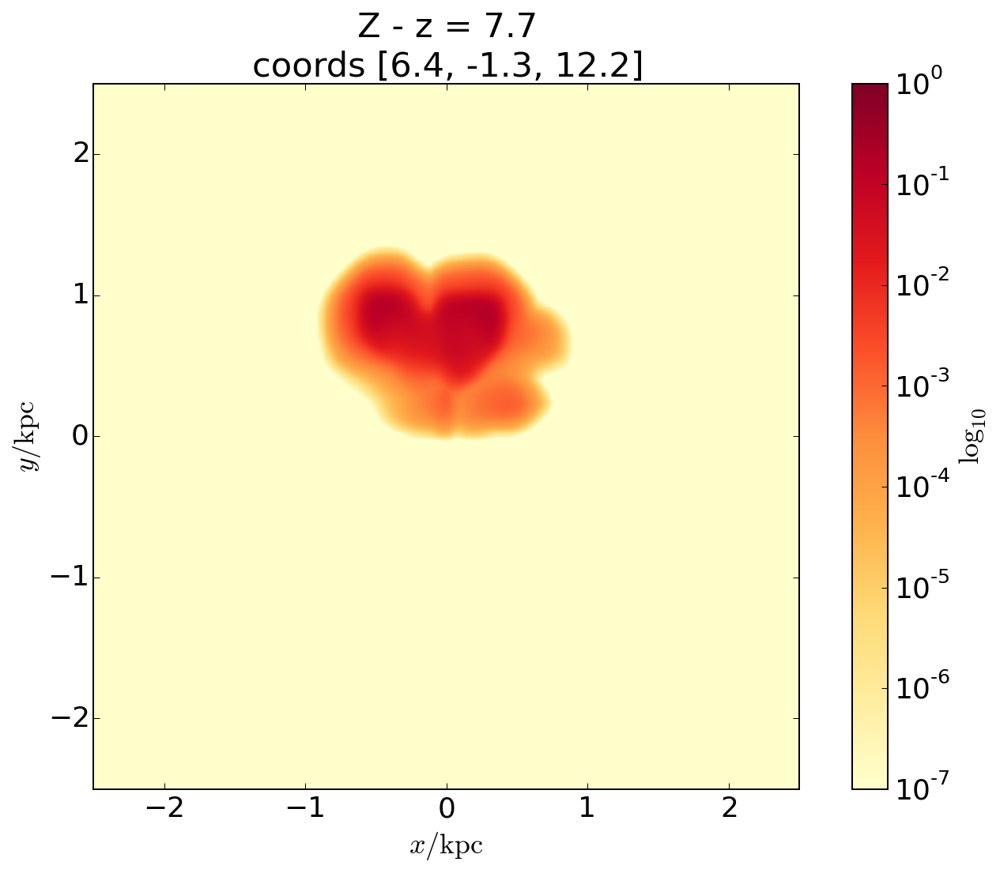

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


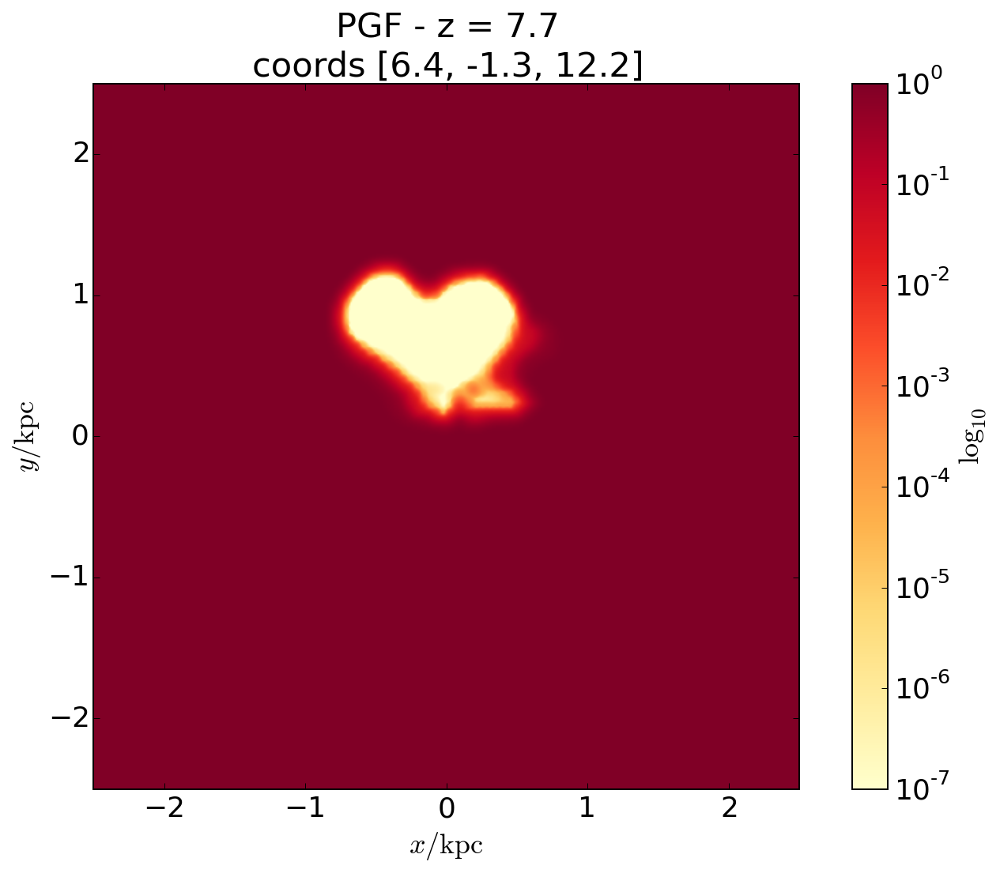

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


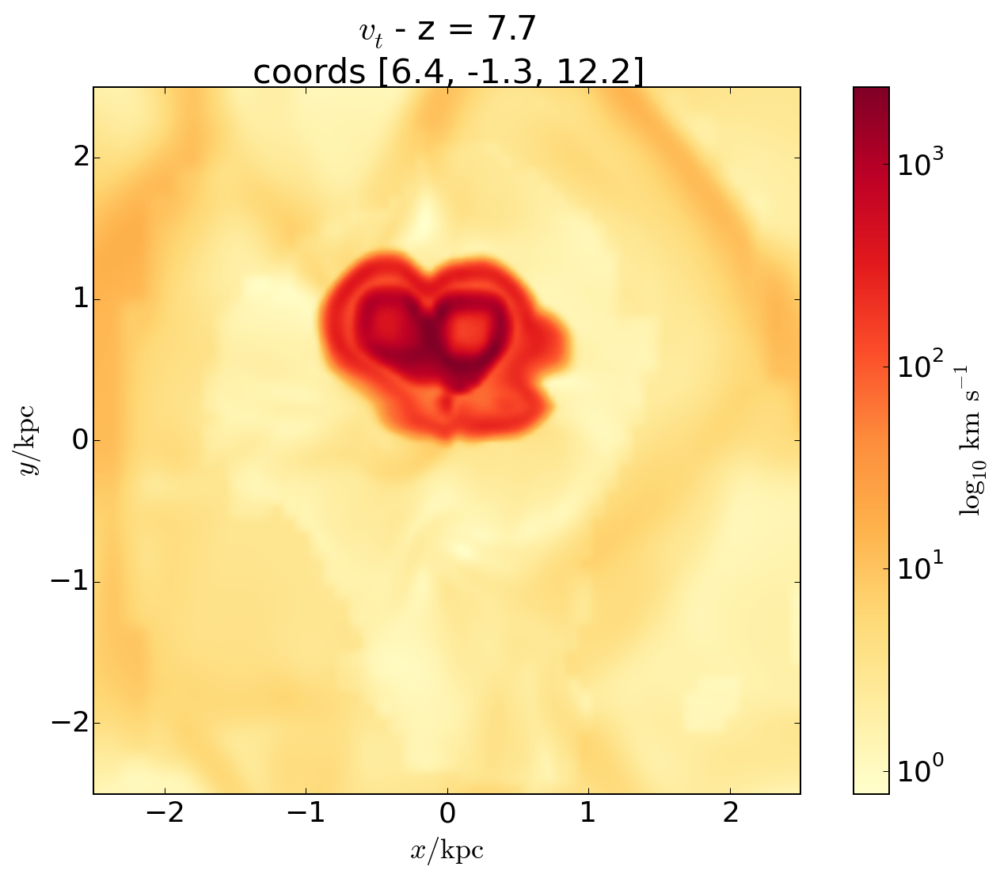

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


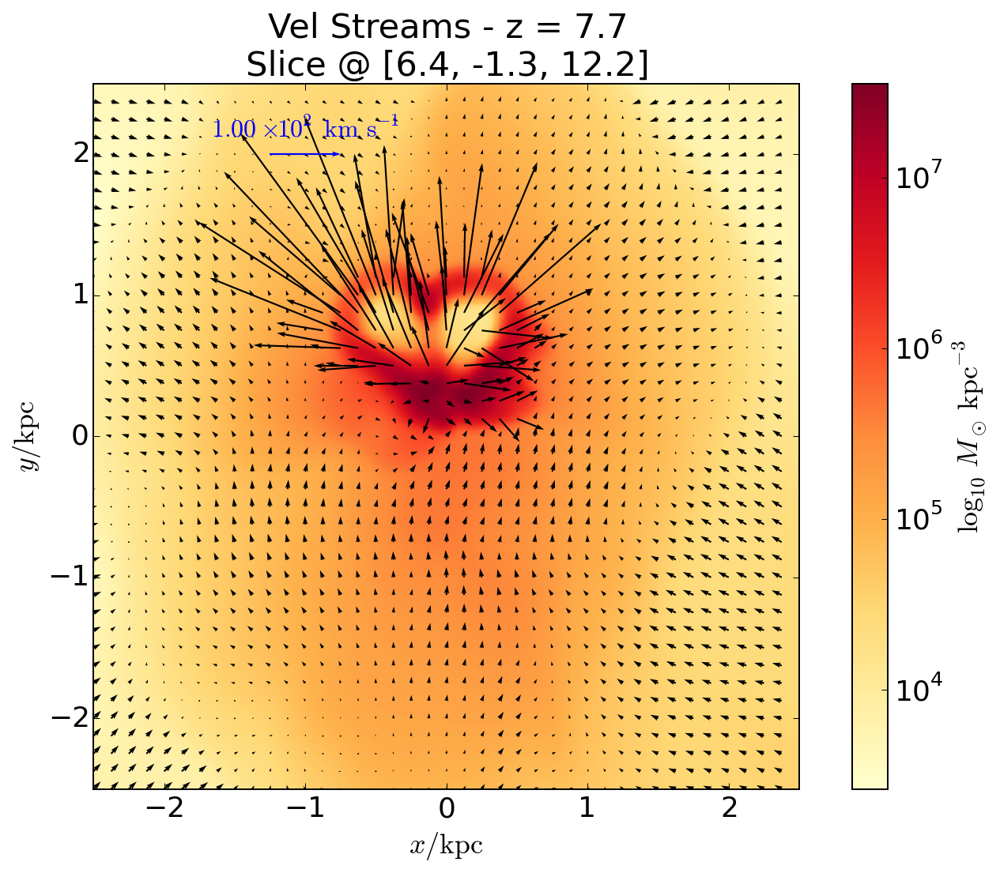

In [28]:
coords2= [6.4,-1.3,12.2] # NOTE WE ARE TRANSLATING... Note quite center, but the SN is at the edge of the box!
smallbox='5.0 kpc'
with pynbody.transformation.translate(s,coords2):
    titleStr = "Z - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams - z = %.1lf" % z + "\nSlice @ %s" % str(coords2)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

In [29]:
snBlast.g['tv'].max()

SimArray(61953.71201930345, 'km s**-1')

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


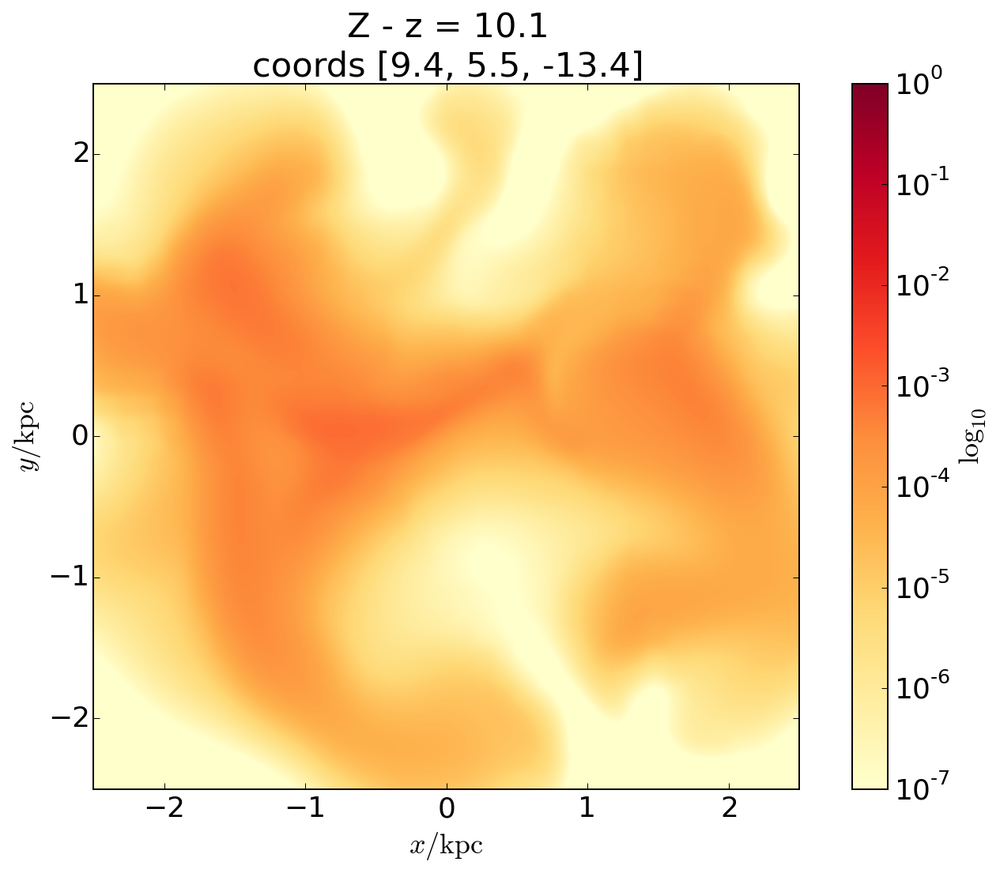

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


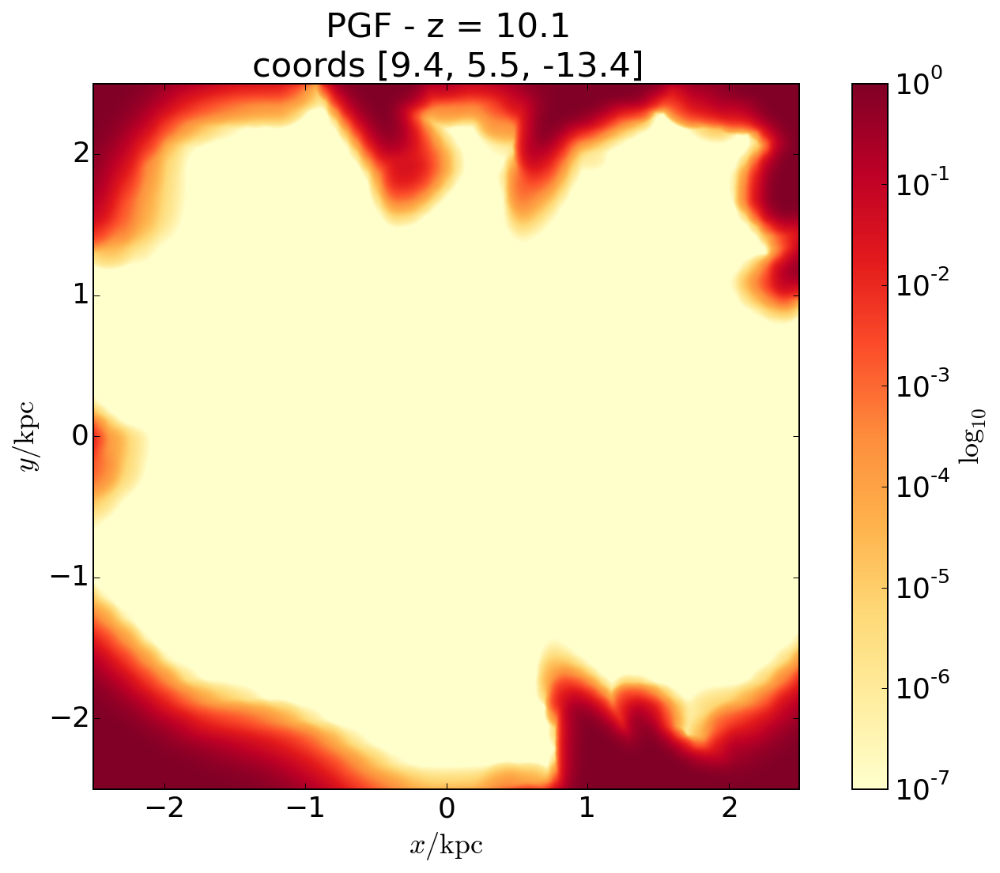

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


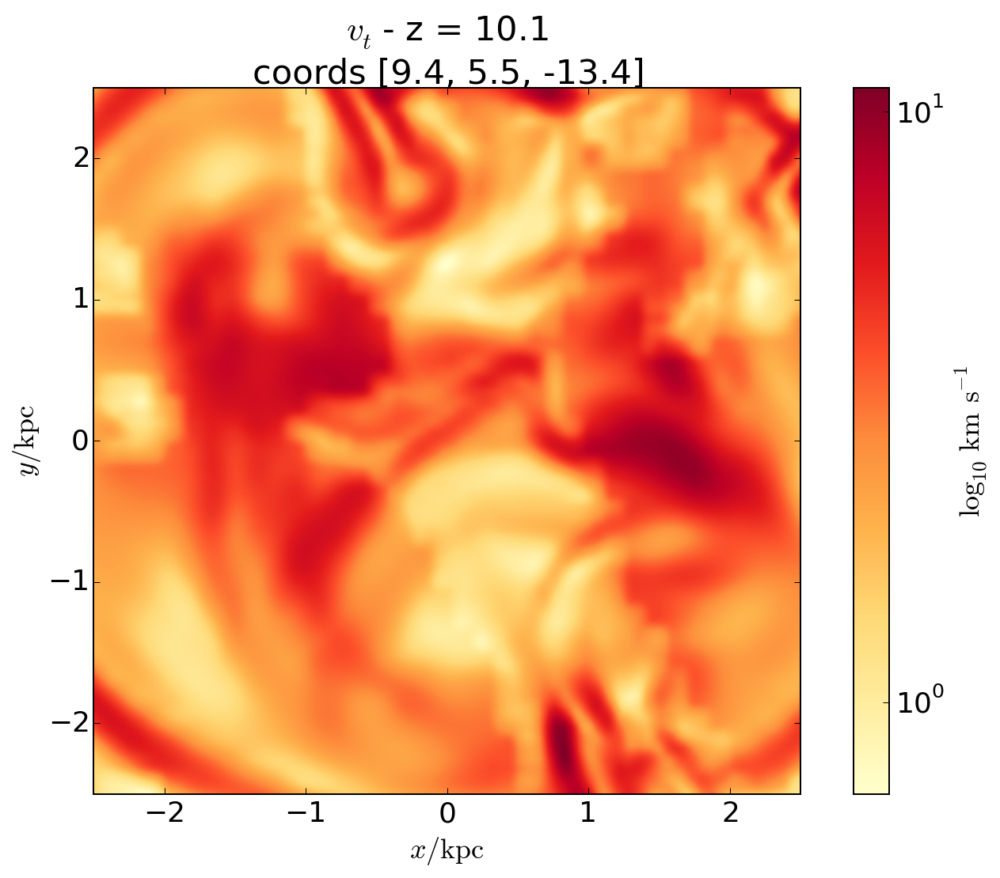

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


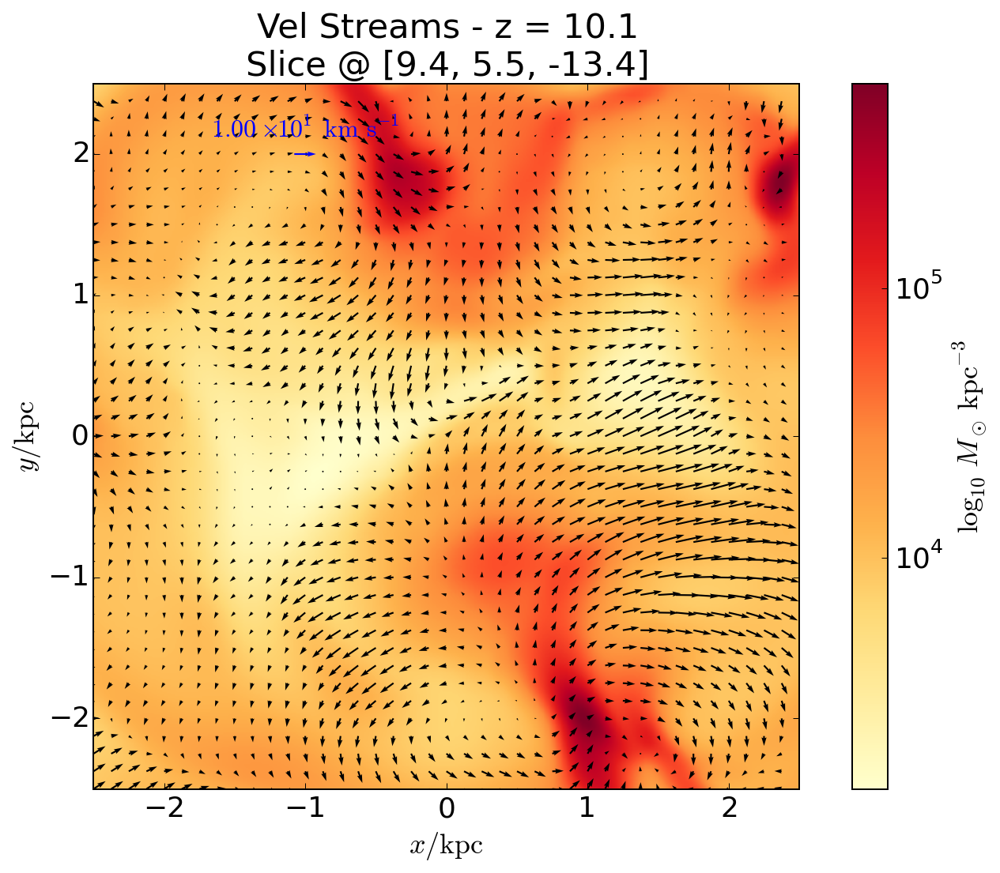

In [43]:
coords2= [9.4, 5.5, -13.4] # NOTE WE ARE TRANSLATING... Note quite center, but the SN is at the edge of the box!
smallbox='5.0 kpc'
with pynbody.transformation.translate(s,coords2):
    titleStr = "Z - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams - z = %.1lf" % z + "\nSlice @ %s" % str(coords2)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='10 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

In [42]:
s.g['mach']=s.g['tv']/s.g['cs']

INFO:pynbody.snapshot:Deriving array cs
INFO:pynbody.snapshot:Deriving array temp
INFO:pynbody.snapshot:Deriving array temp
INFO:pynbody.snapshot:Deriving array u
INFO:pynbody.snapshot:Deriving array mu
INFO:pynbody.snapshot:Converting temp units from k K m_p**-1 to km**2 s**-2
INFO:pynbody.snapshot:Converting temp units from 2.24e+00 K**1/2 k**1/2 m_p**-1/2 to km s**-1


INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


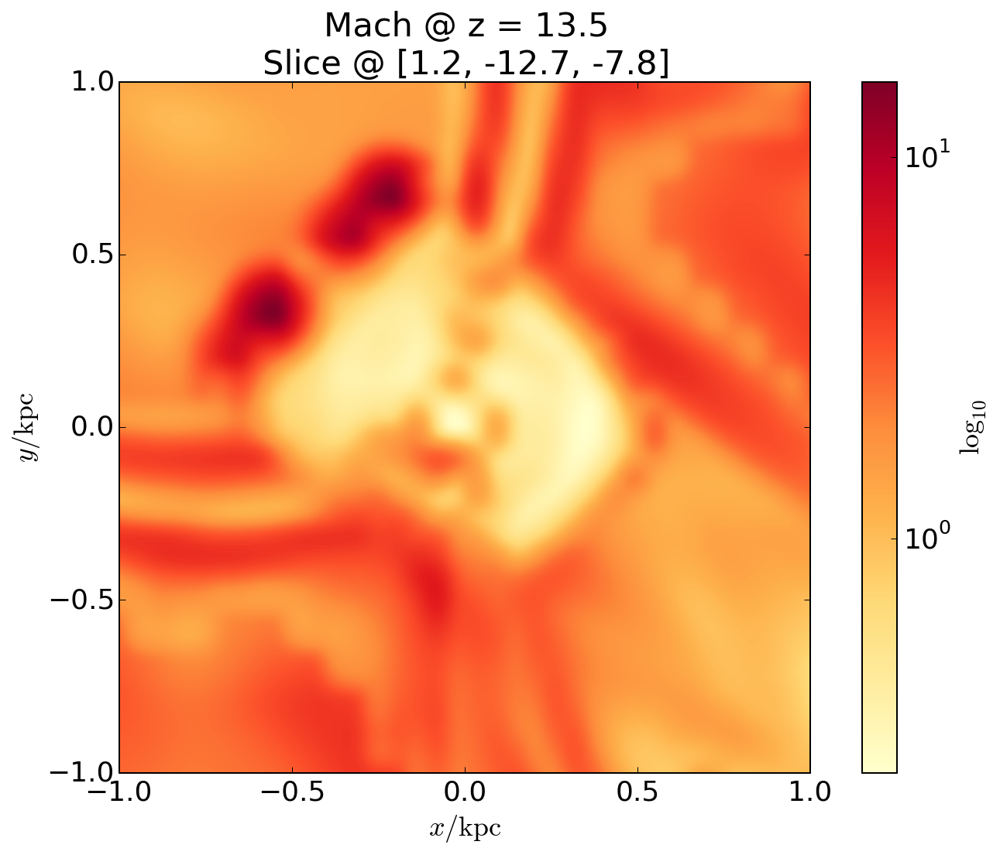

In [43]:
with pynbody.transformation.translate(snBlast,coords):
    titleStr = "Mach @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.image(snBlast.g,qty="mach",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


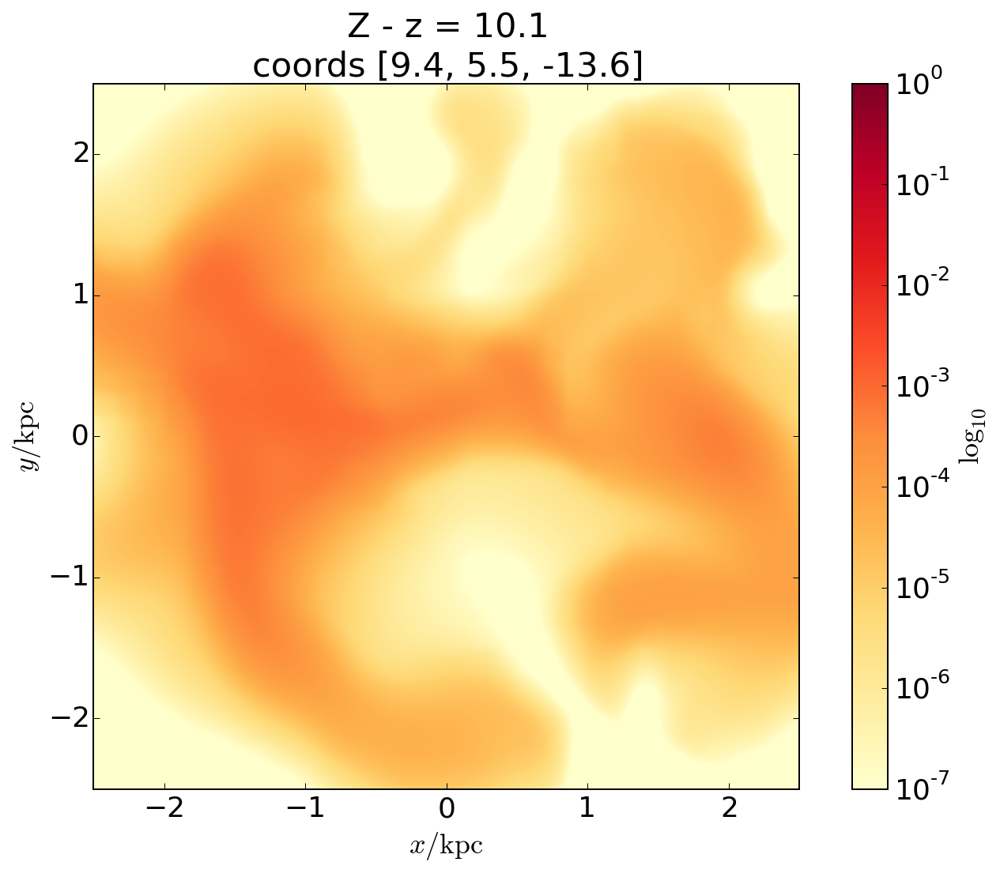

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


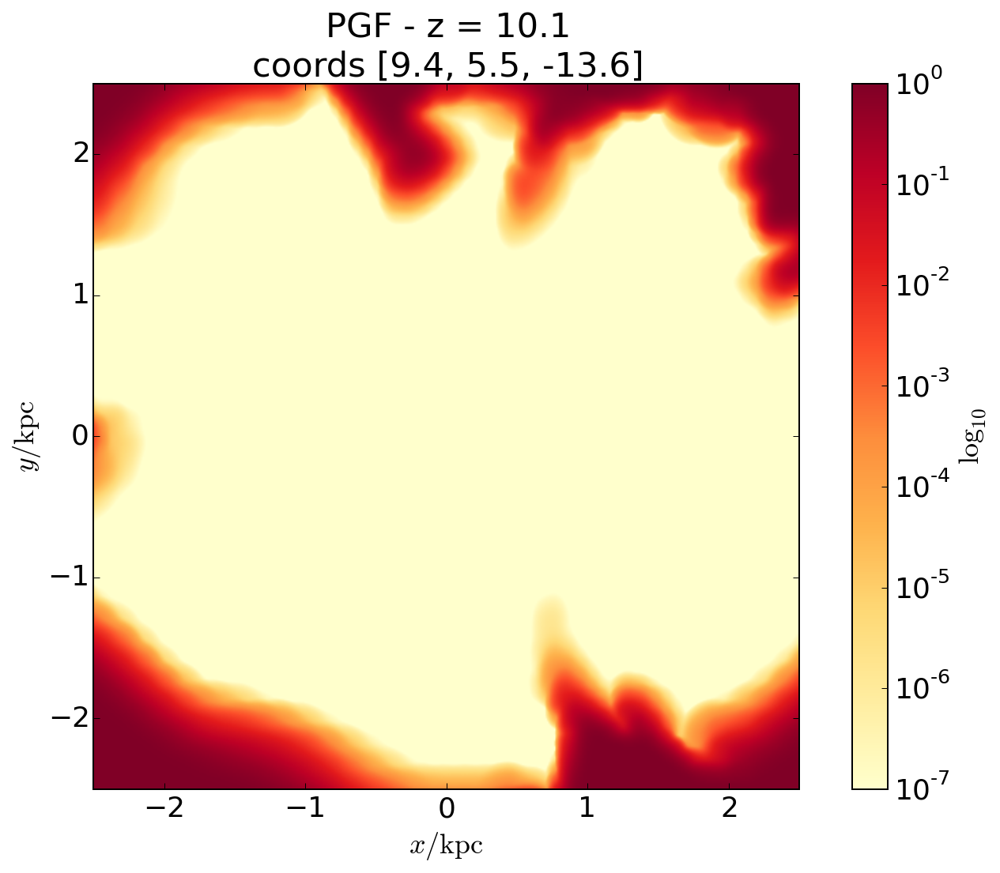

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


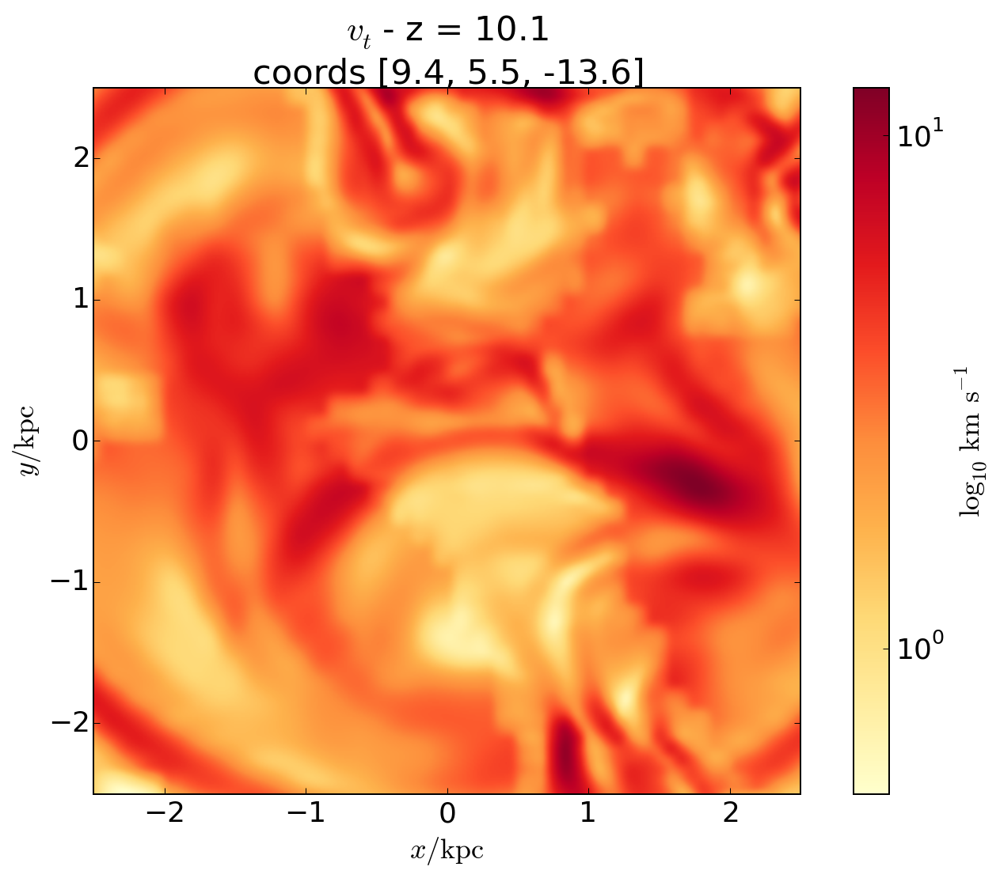

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


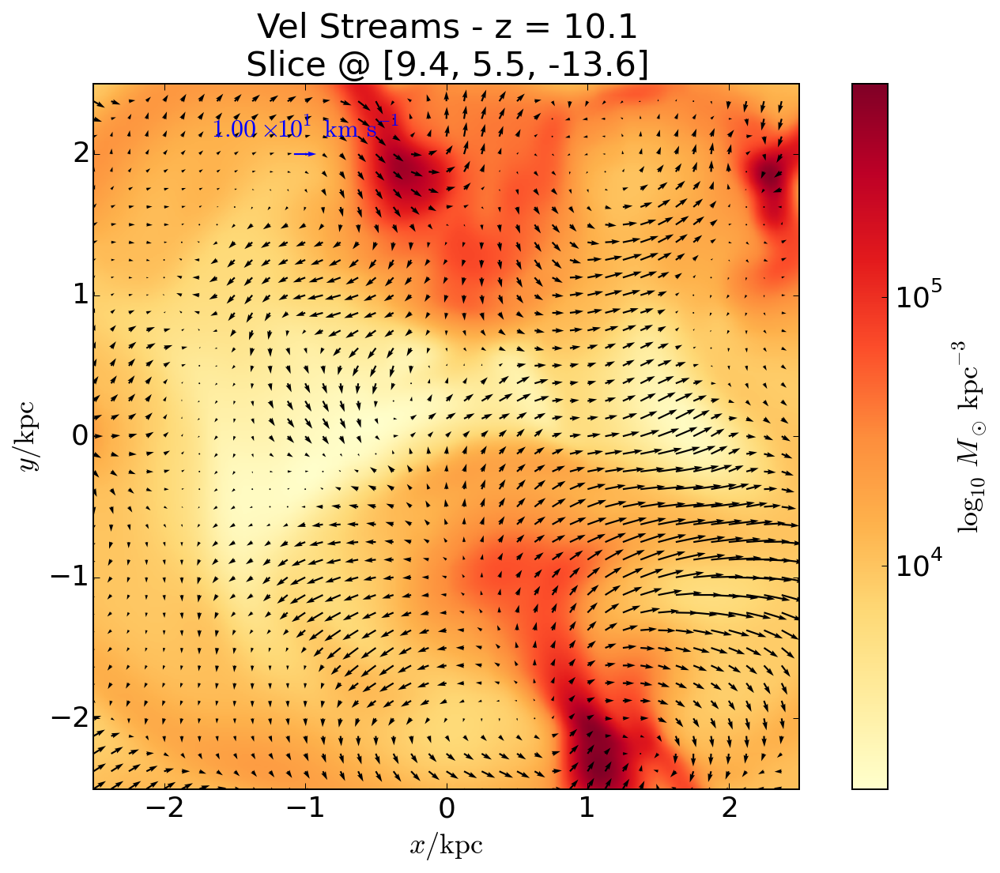

In [50]:
coords2= [9.4, 5.5, -13.6] # NOTE WE ARE TRANSLATING... Note quite center, but the SN is at the edge of the box!
smallbox='5.0 kpc'
with pynbody.transformation.translate(s,coords2):
    titleStr = "Z - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams - z = %.1lf" % z + "\nSlice @ %s" % str(coords2)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='10 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


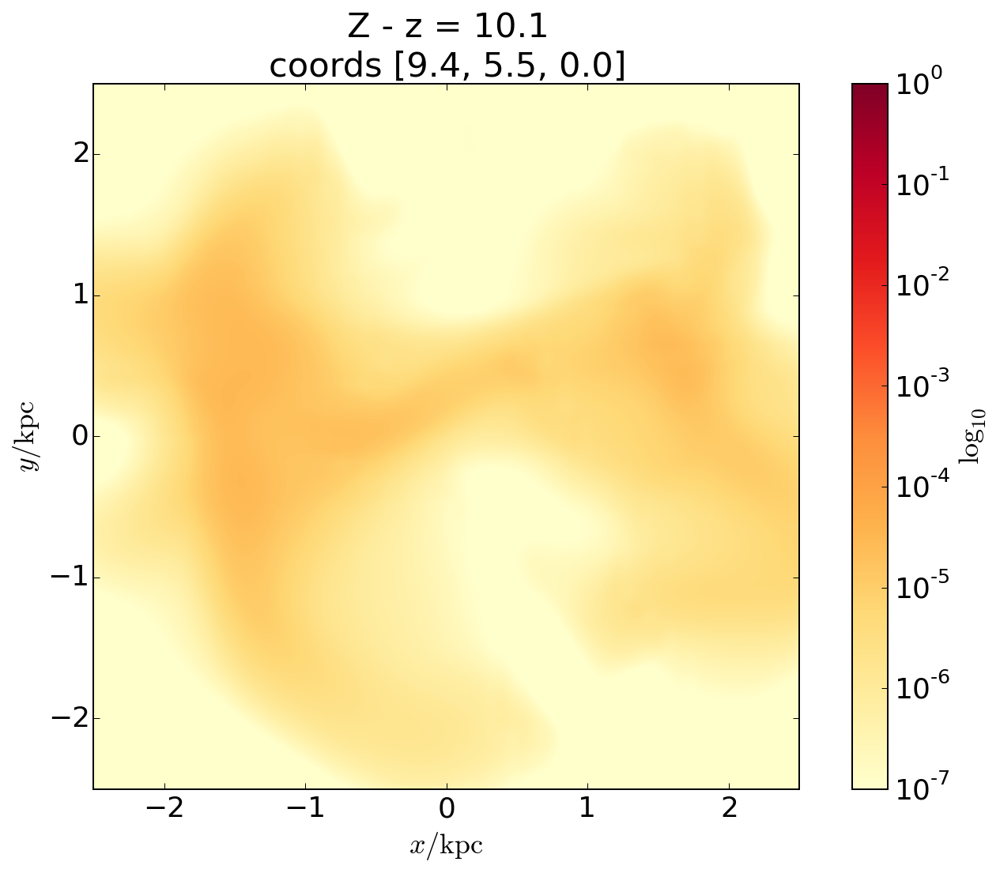

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


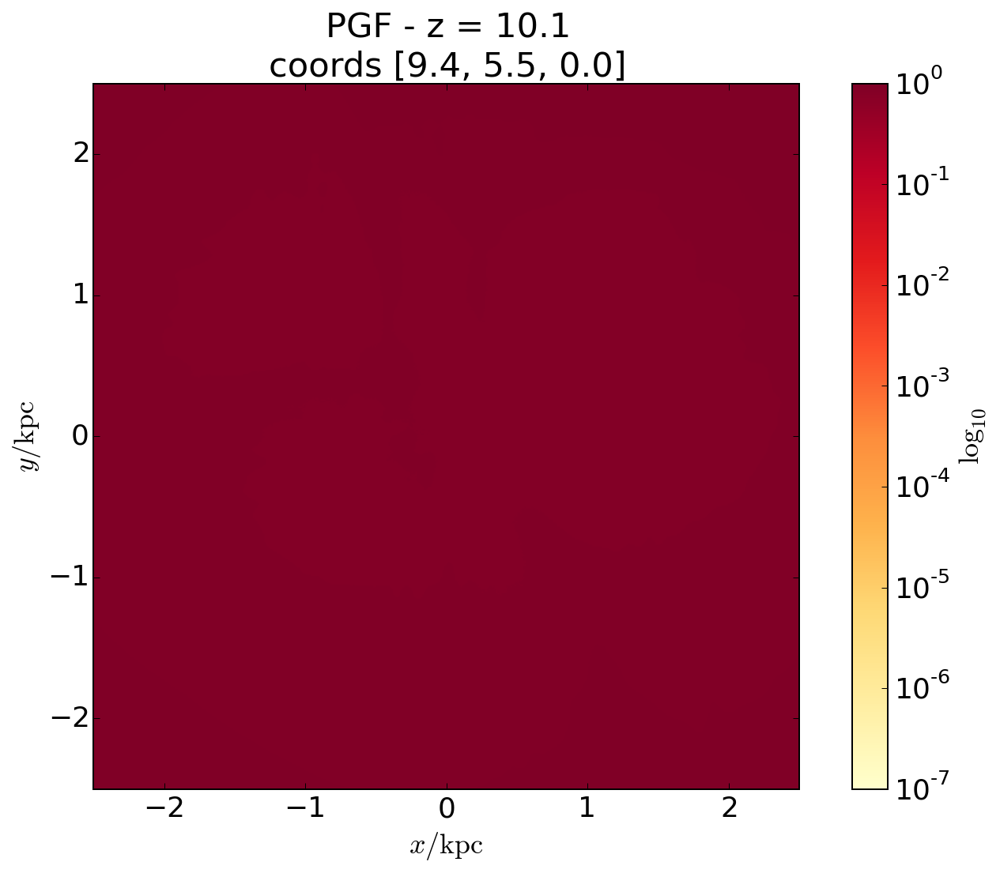

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


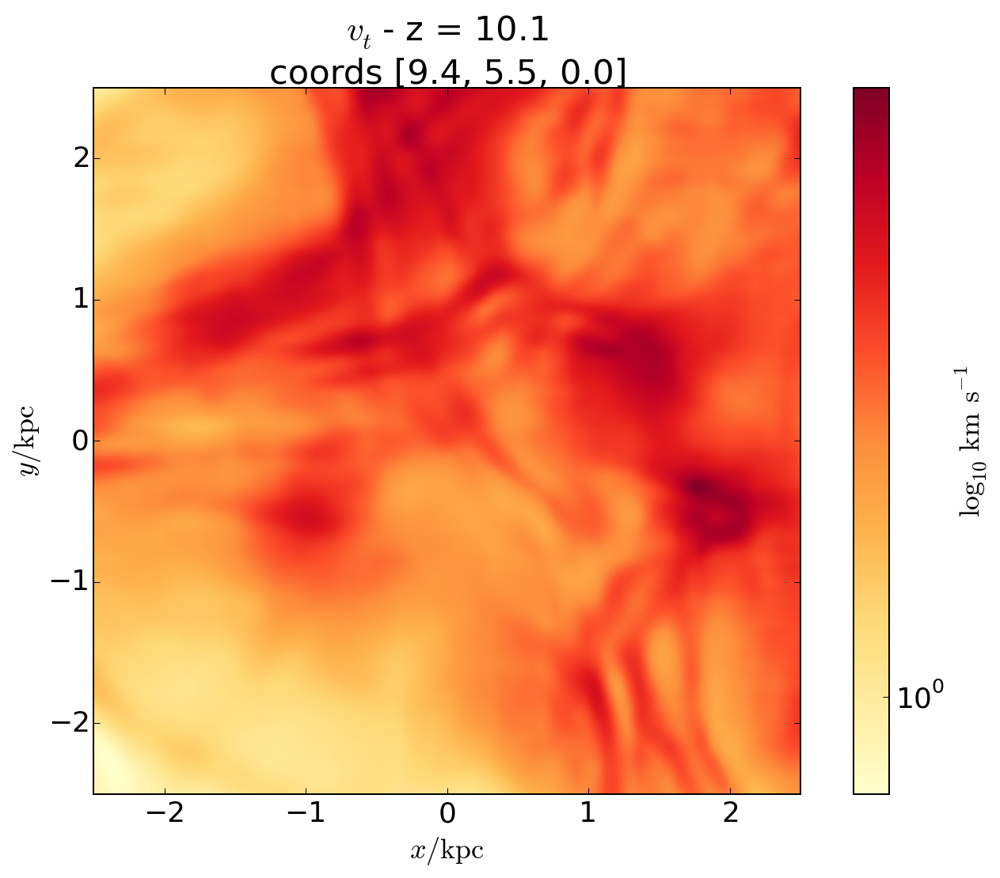

In [46]:
coords2= [9.4, 5.5, 0.0] # NOTE WE ARE TRANSLATING... Note quite center, but the SN is at the edge of the box!
smallbox='5.0 kpc'
with pynbody.transformation.translate(s,coords2):
    titleStr = "Z - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=True, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=True, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=True, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


SimArray([[ 1.,  1.,  1., ...,  1.,  1.,  1.],
       [ 1.,  1.,  1., ...,  1.,  1.,  1.],
       [ 1.,  1.,  1., ...,  1.,  1.,  1.],
       ..., 
       [ 1.,  1.,  1., ...,  1.,  1.,  1.],
       [ 1.,  1.,  1., ...,  1.,  1.,  1.],
       [ 1.,  1.,  1., ...,  1.,  1.,  1.]], dtype=float32)

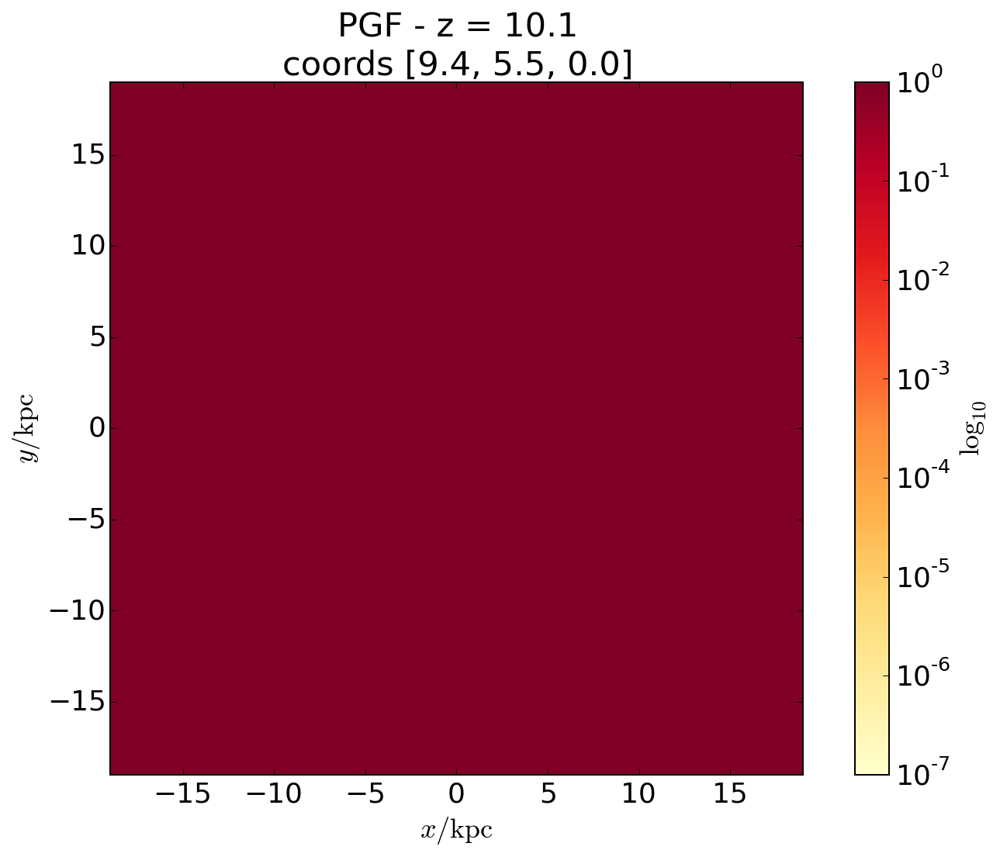

In [48]:
titleStr = "PGF - z = %.1lf" % z + "\ncoords %s"%str(coords2)
sph.image(s.g,qty="pgf",width=boxsizestring,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,



In [49]:
titleStr = "Z - z = %.1lf" % z + "\ncoords %s"%str(coords2)
sph.image(s.g,qty="metal",width=boxsizestring,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,




INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


ValueError: Failed to make a sensible logarithmic image. This probably means there are no particles in the view.

In [45]:
snBlast.g['mach'].max()

SimArray(32.98736064250052, '1.00e+00')

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


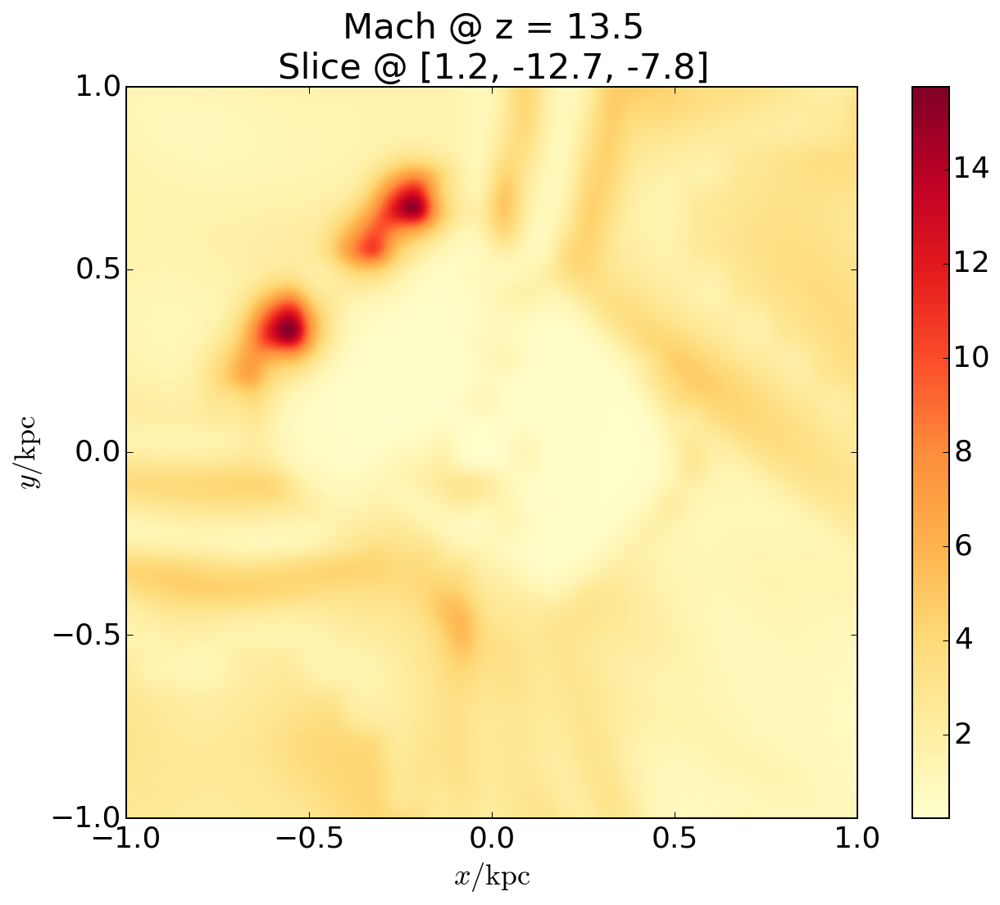

In [44]:
with pynbody.transformation.translate(snBlast,coords):
    titleStr = "Mach @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.image(snBlast.g,qty="mach",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=False, 
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


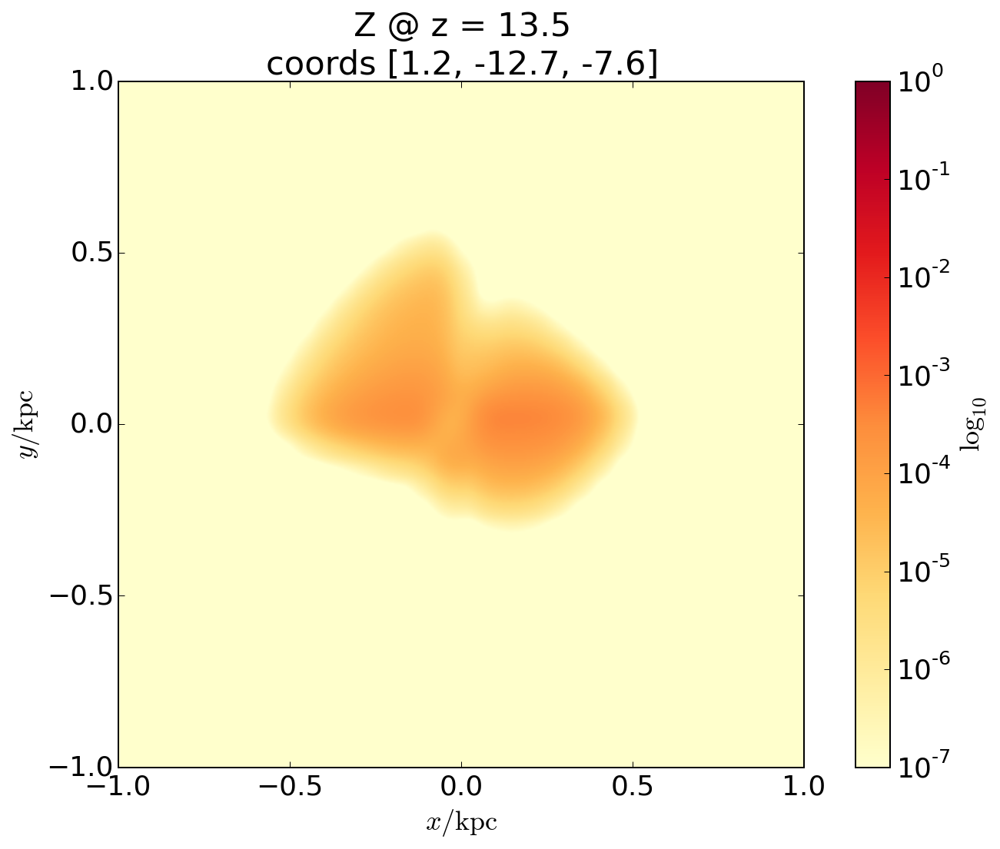

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


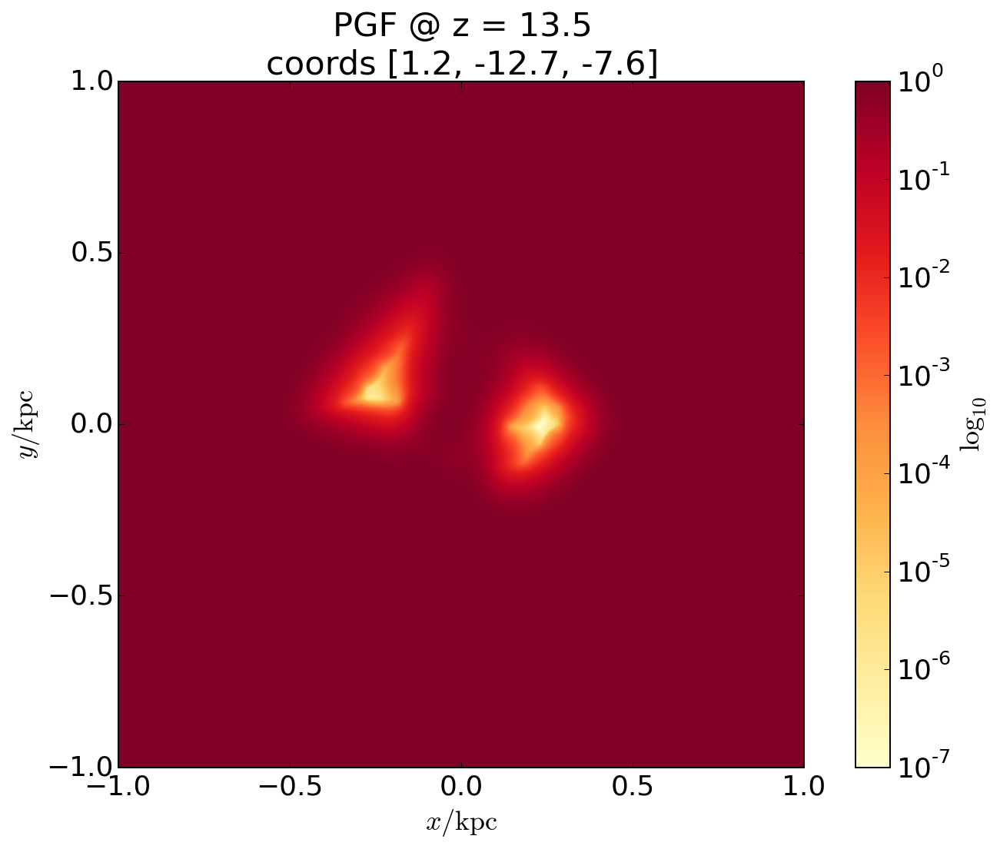

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


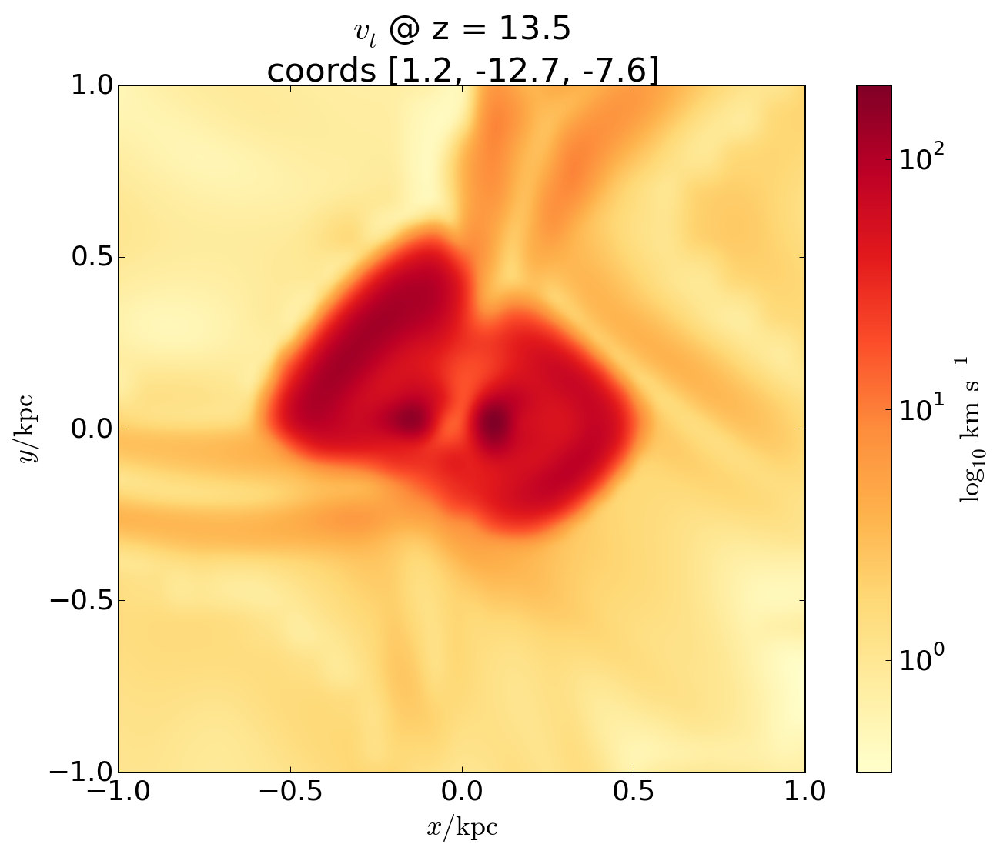

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


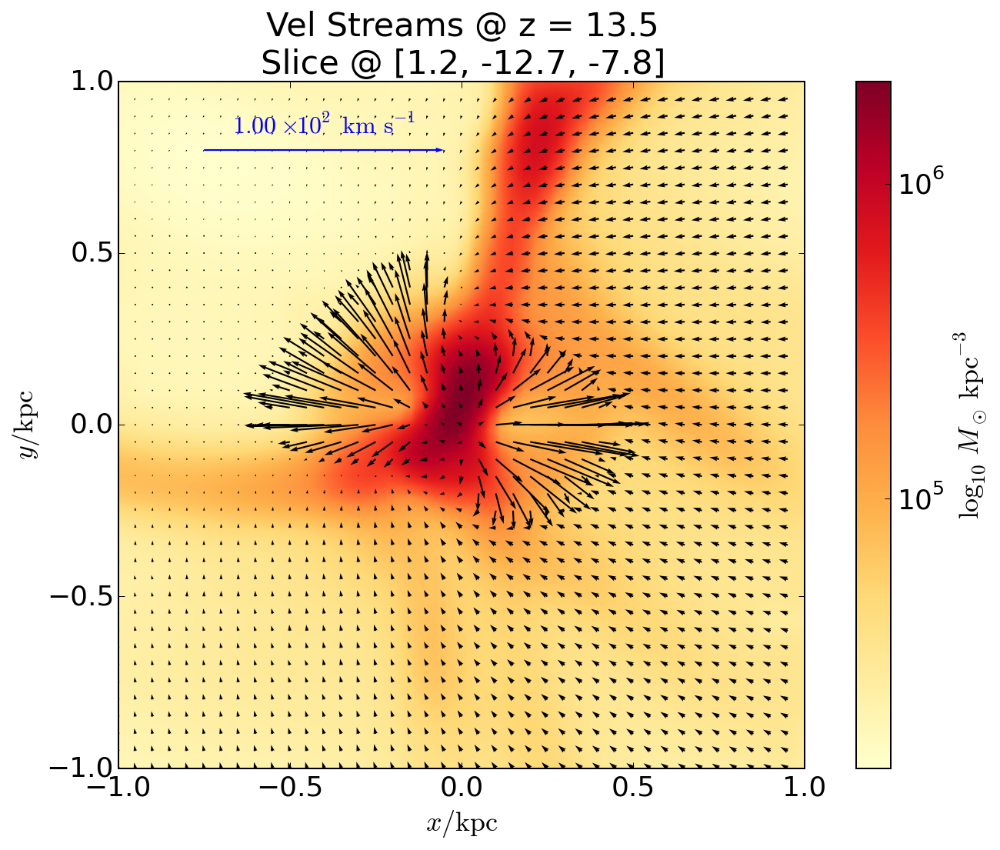

In [54]:
coords2= [1.2,-12.7,-7.6] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
smallbox='2 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z @ z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams @ z = %.1lf" % z + " @ %s" % str(coords)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


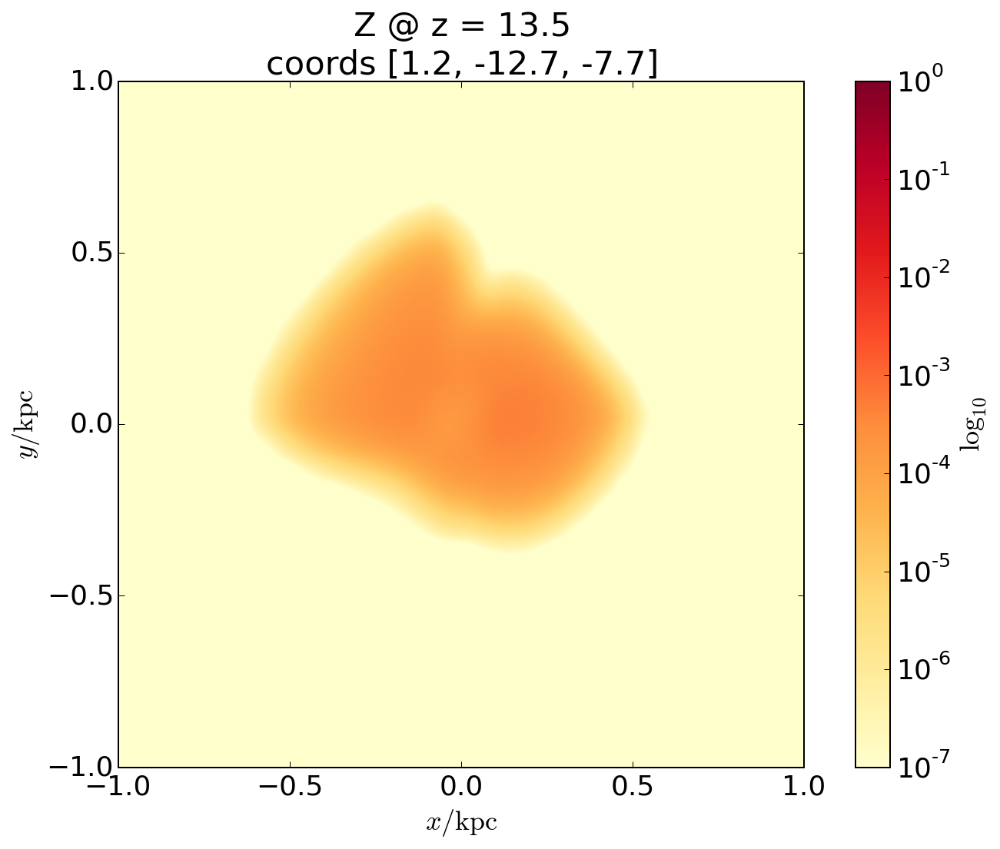

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


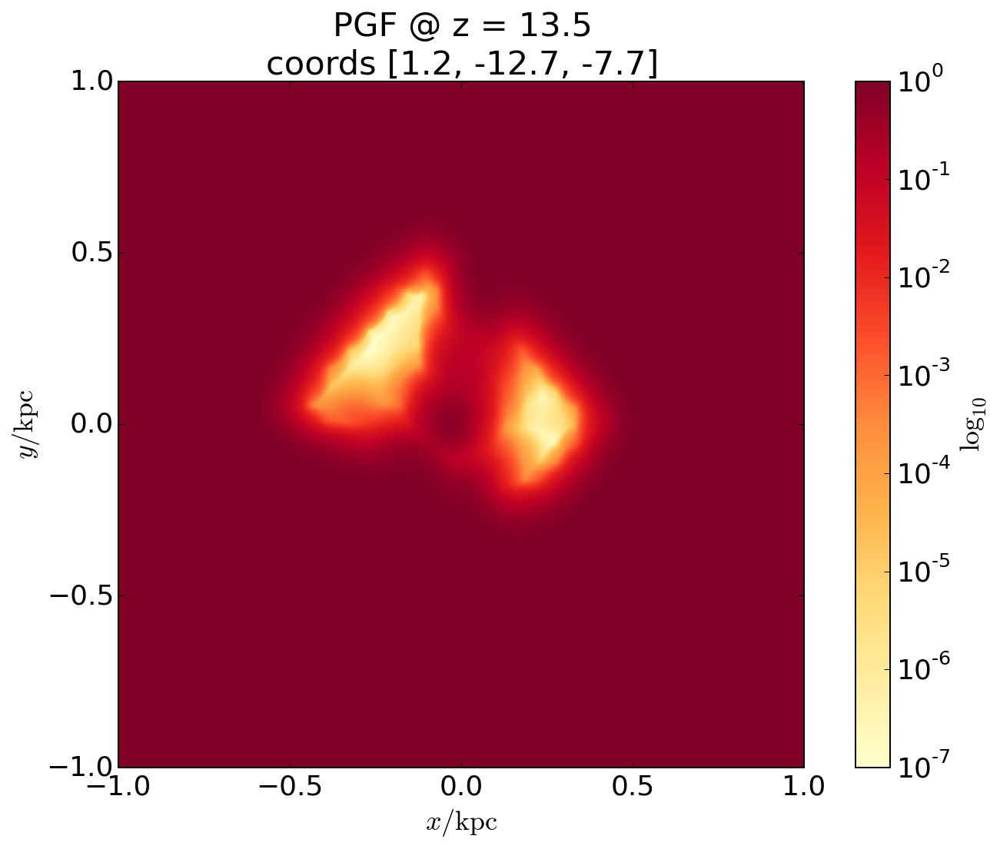

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


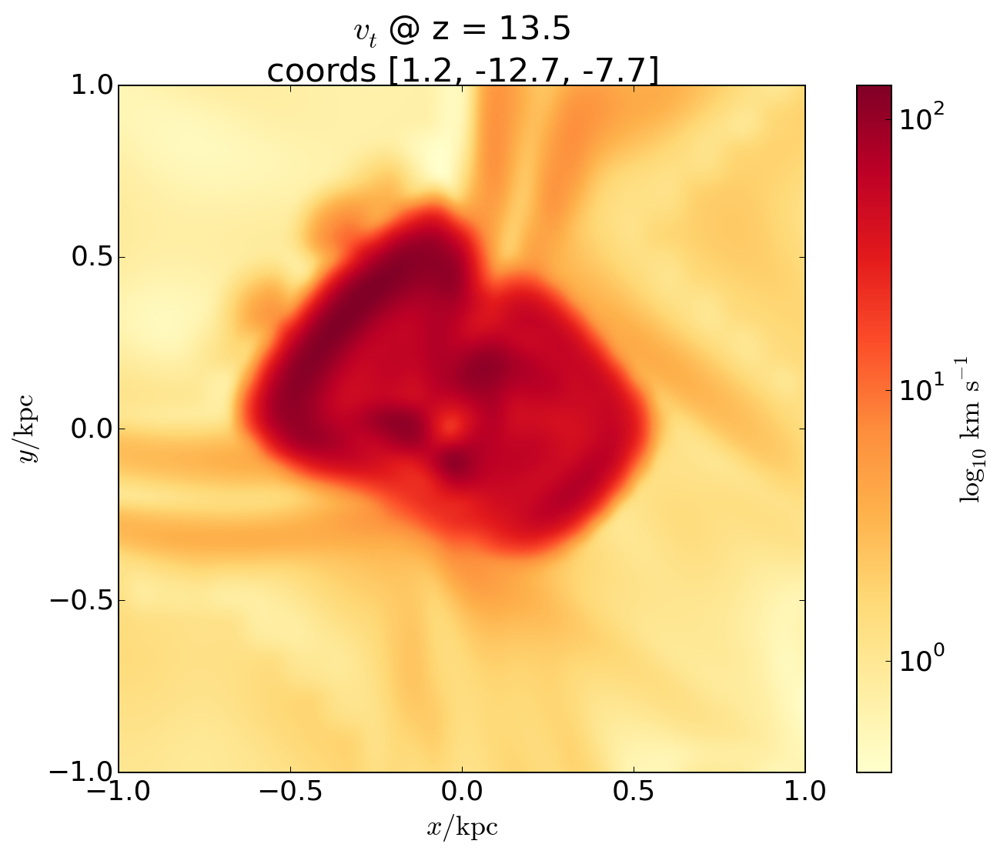

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


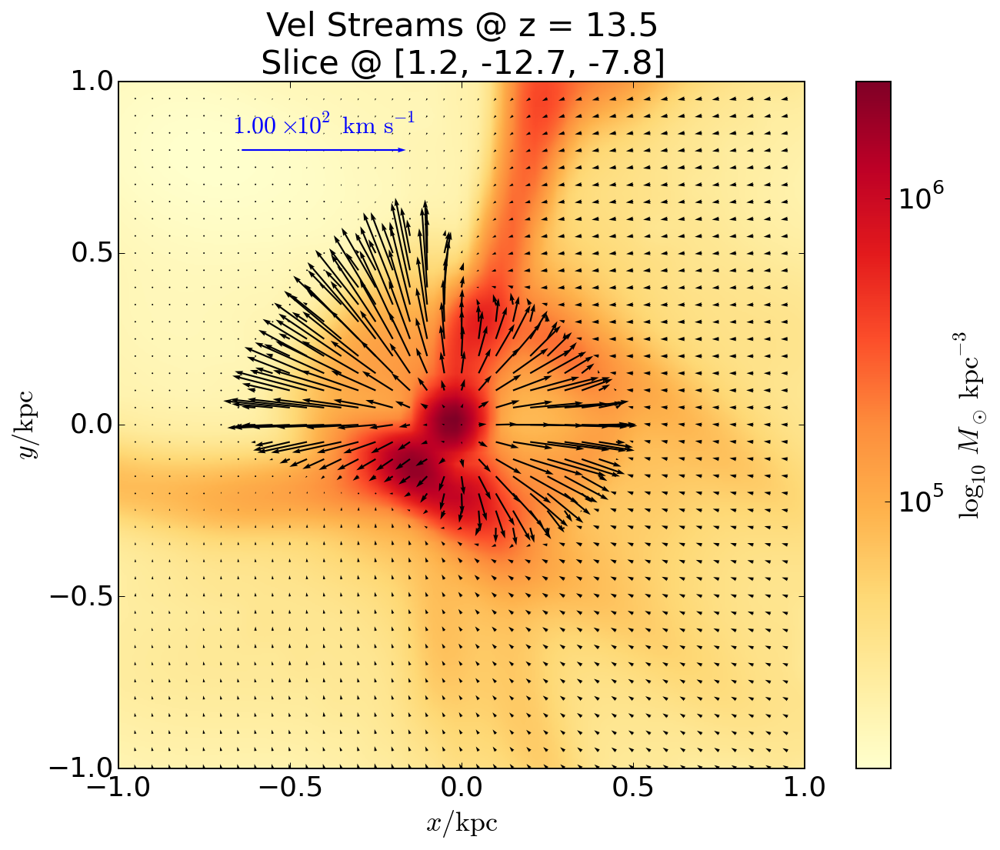

In [55]:
coords2= [1.2,-12.7,-7.7] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
smallbox='2 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z @ z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams @ z = %.1lf" % z + " @ %s" % str(coords)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


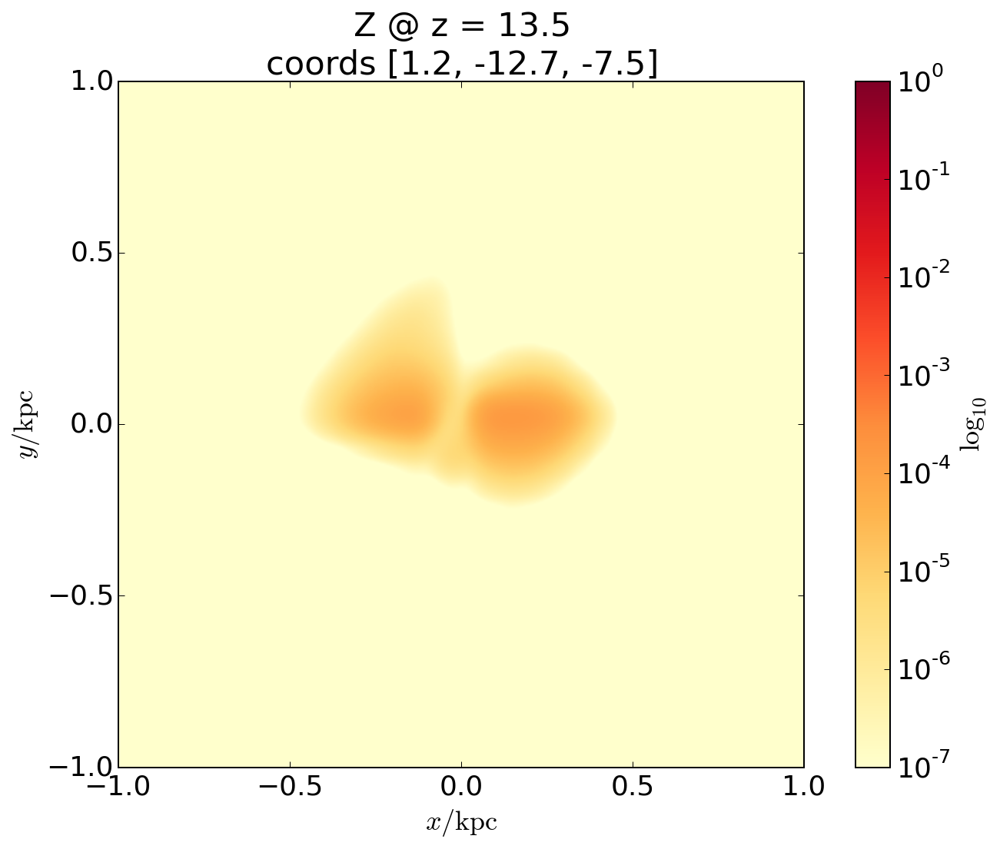

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


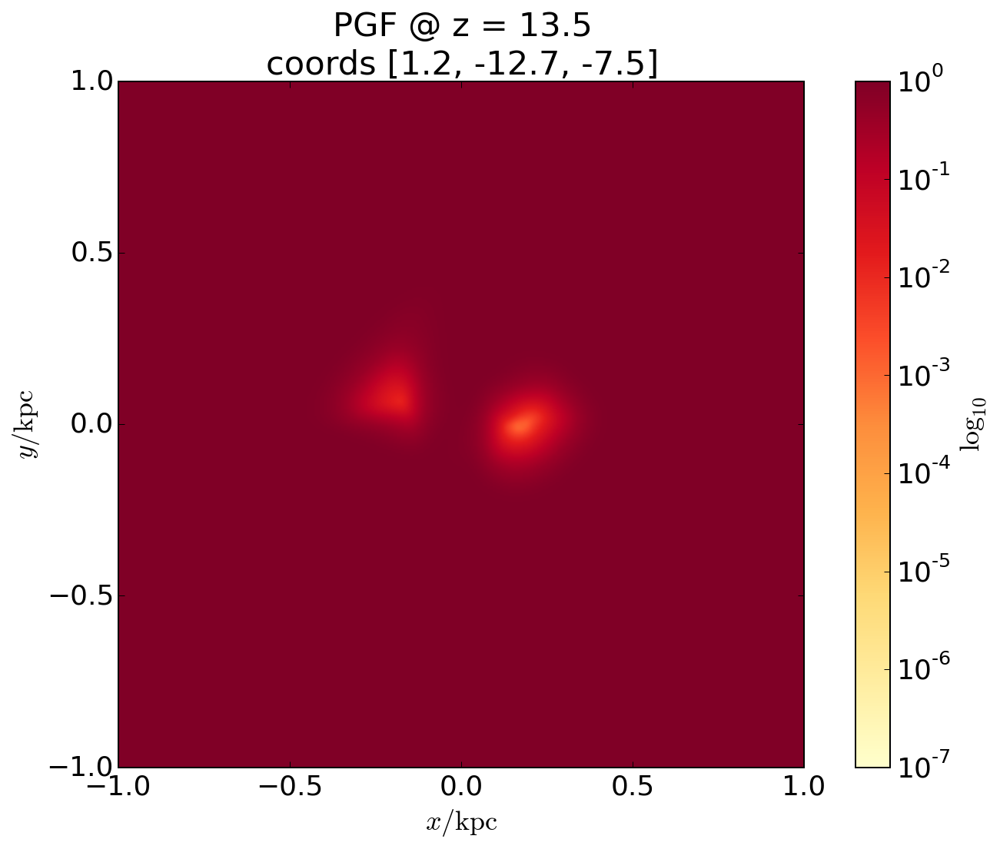

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


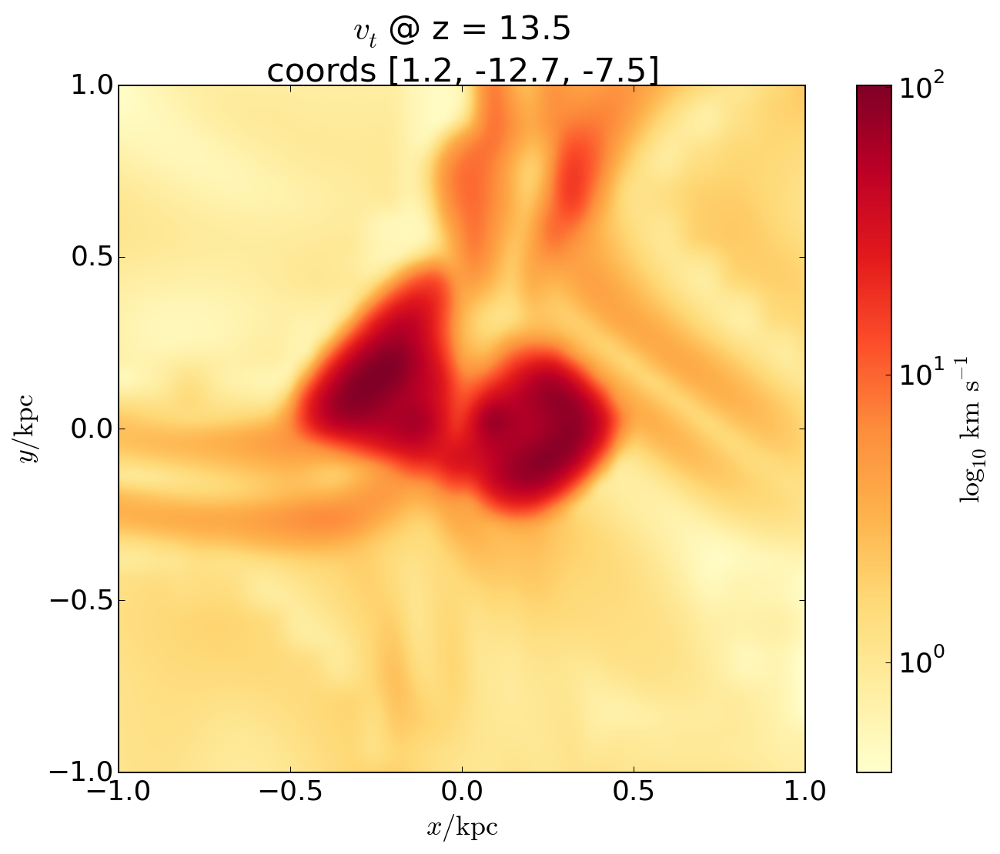

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


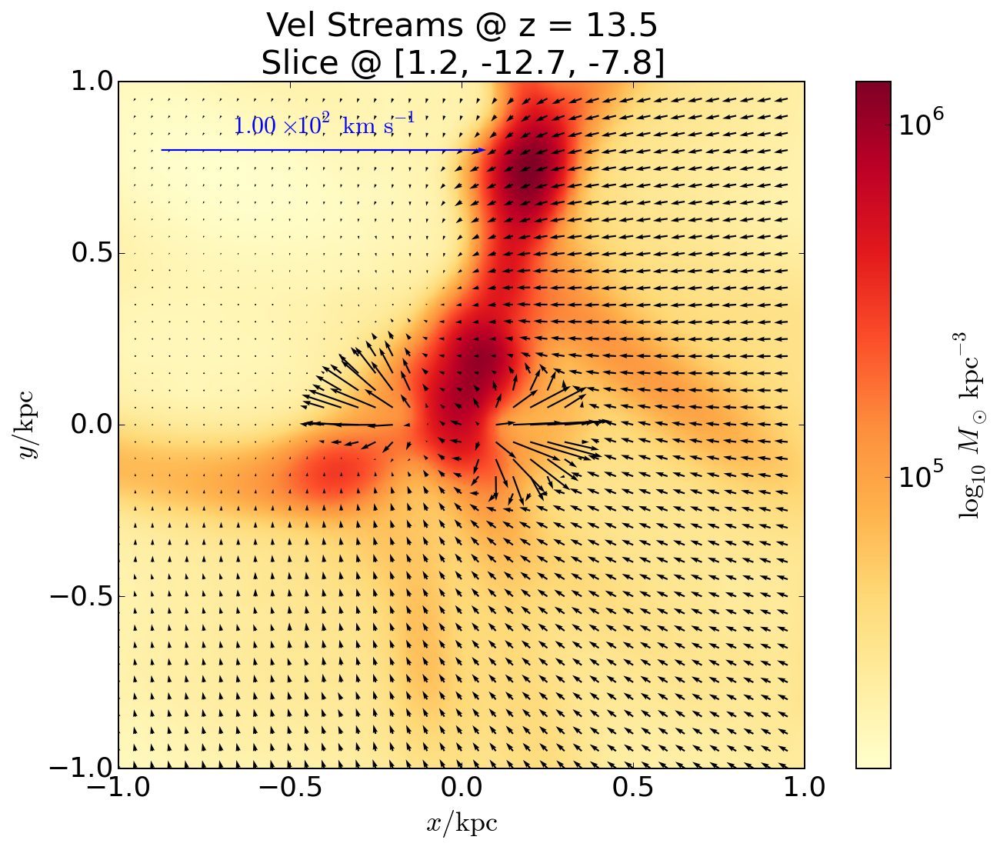

In [56]:
coords2= [1.2,-12.7,-7.5] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
smallbox='2 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z @ z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams @ z = %.1lf" % z + " @ %s" % str(coords)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


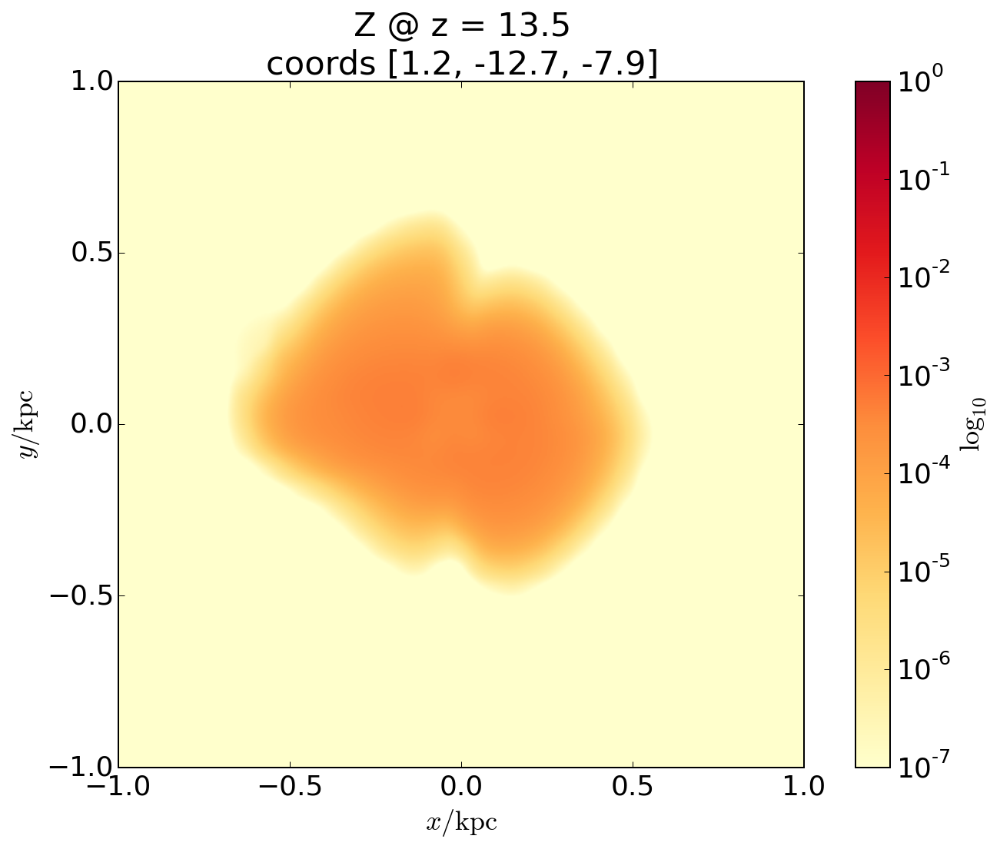

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


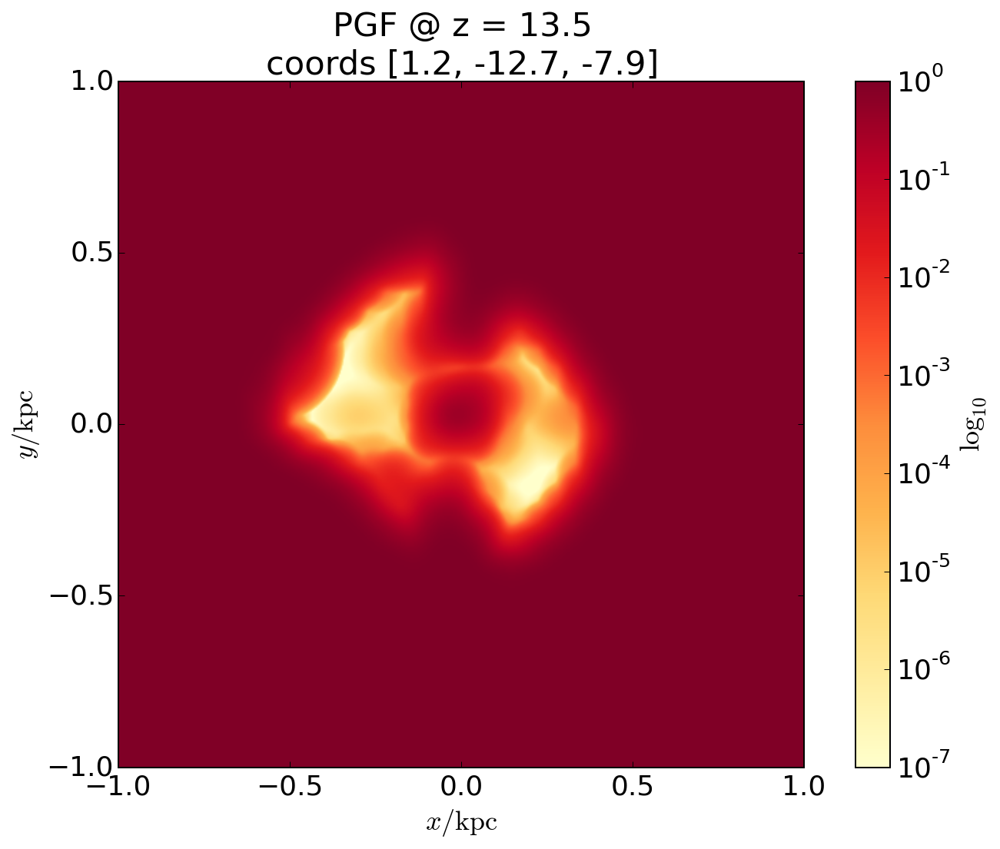

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


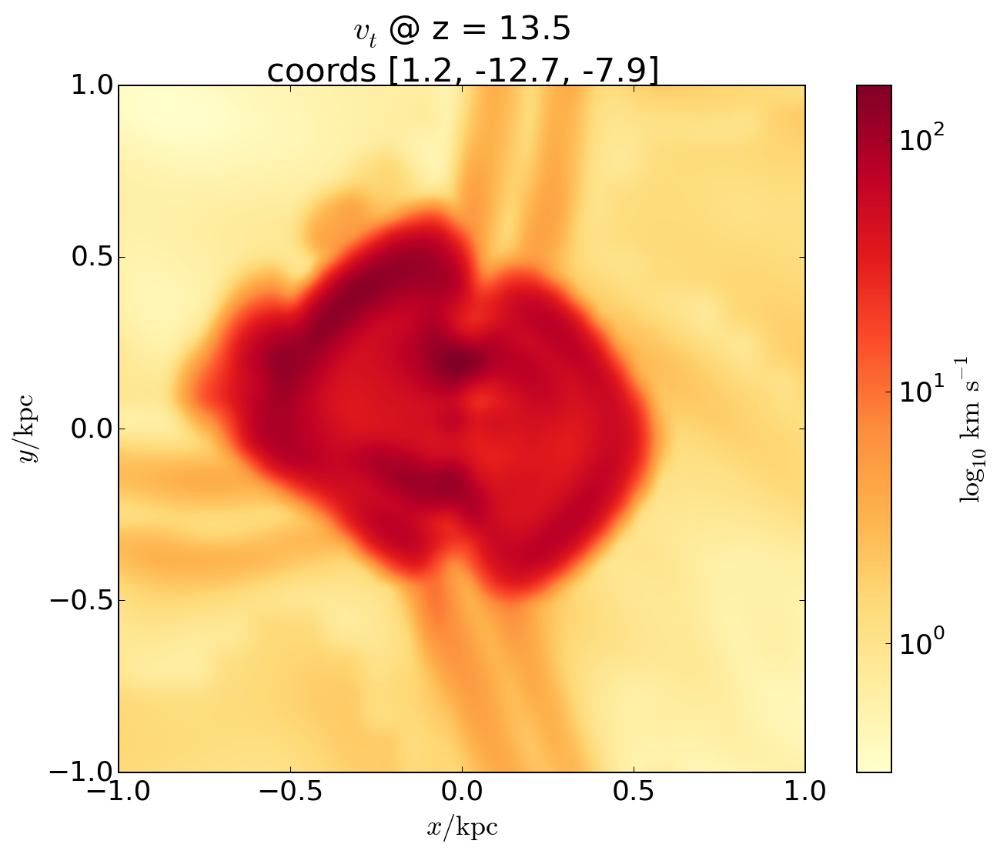

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


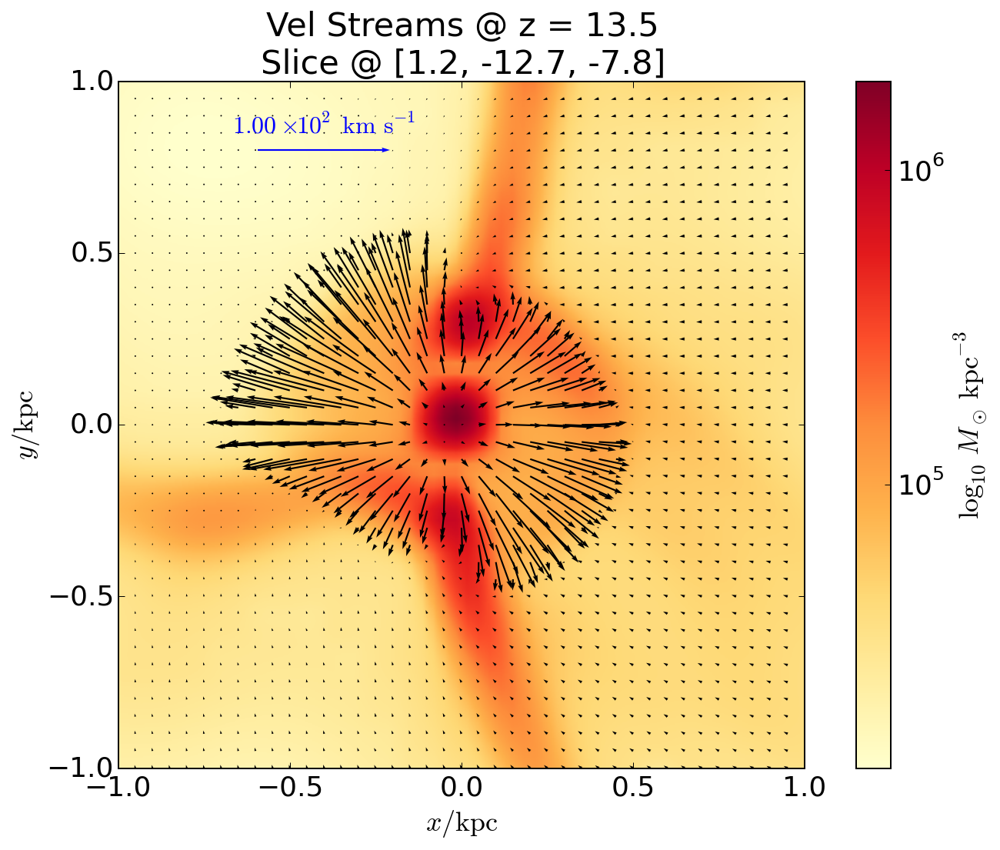

In [57]:
coords2= [1.2,-12.7,-7.9] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
smallbox='2 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z @ z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams @ z = %.1lf" % z + " @ %s" % str(coords)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


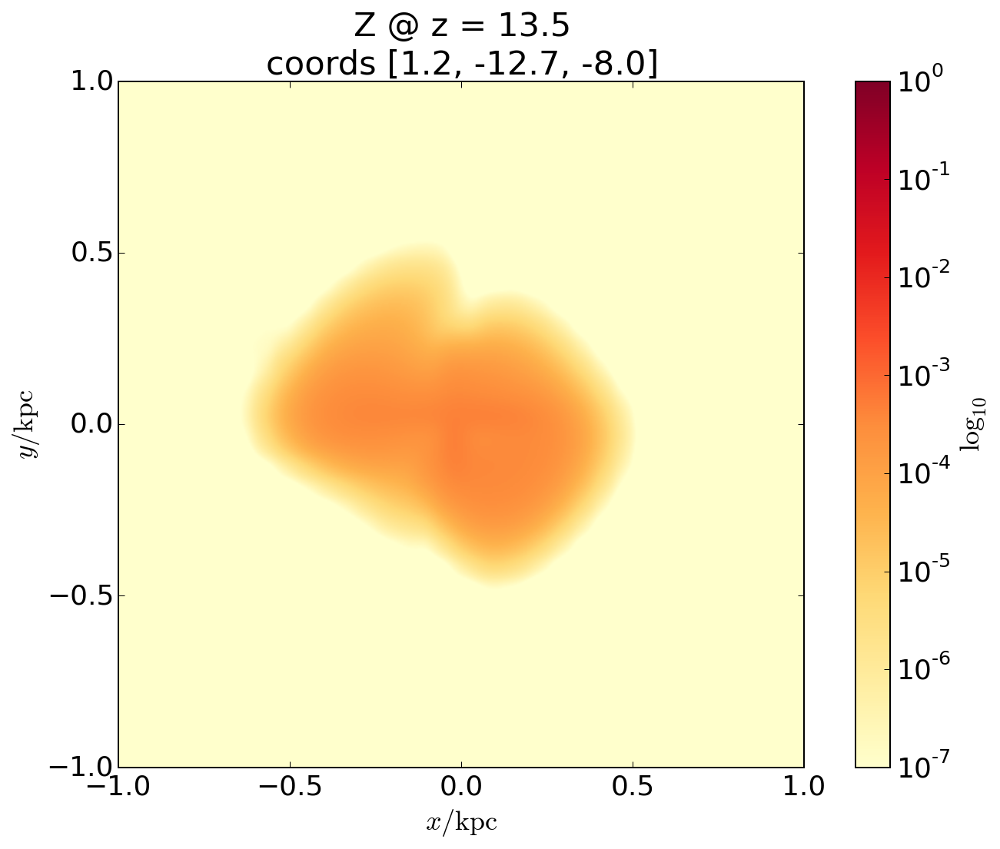

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


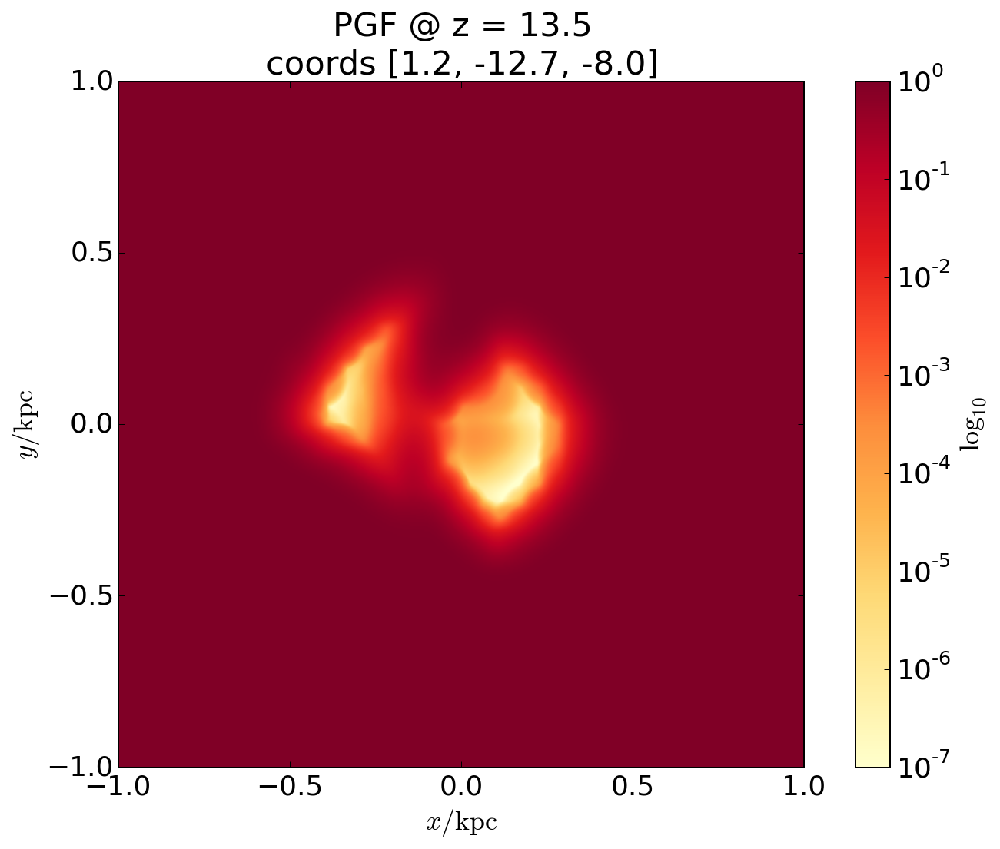

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


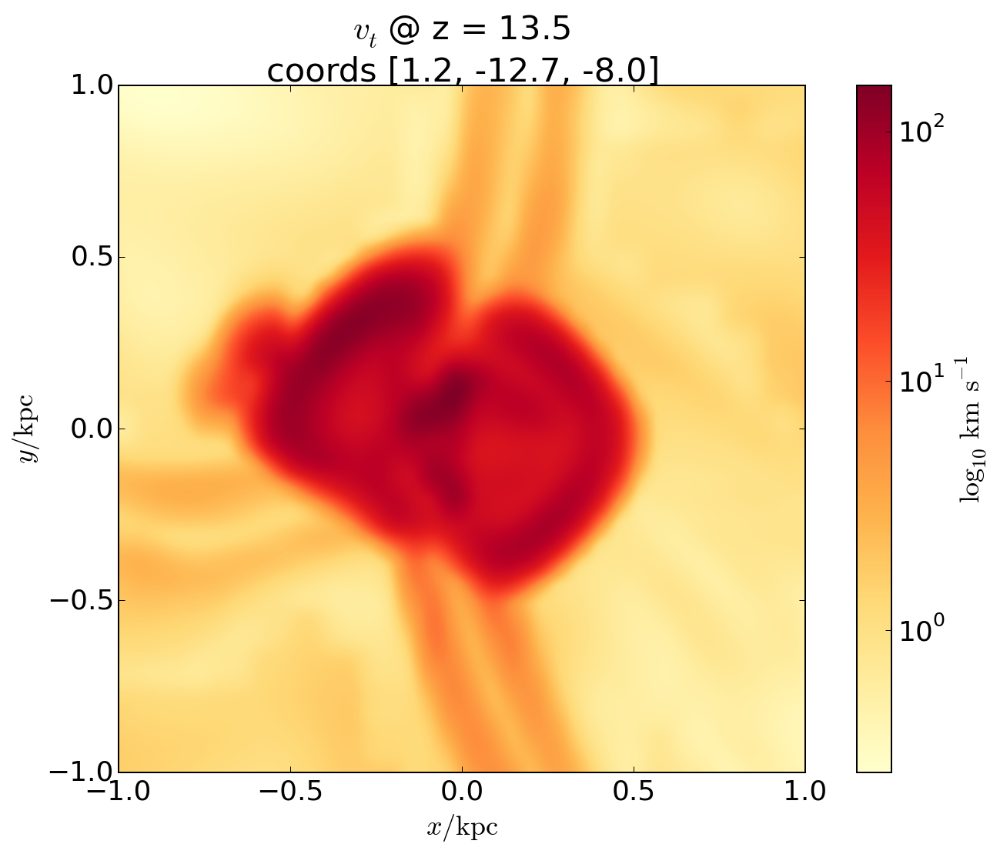

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


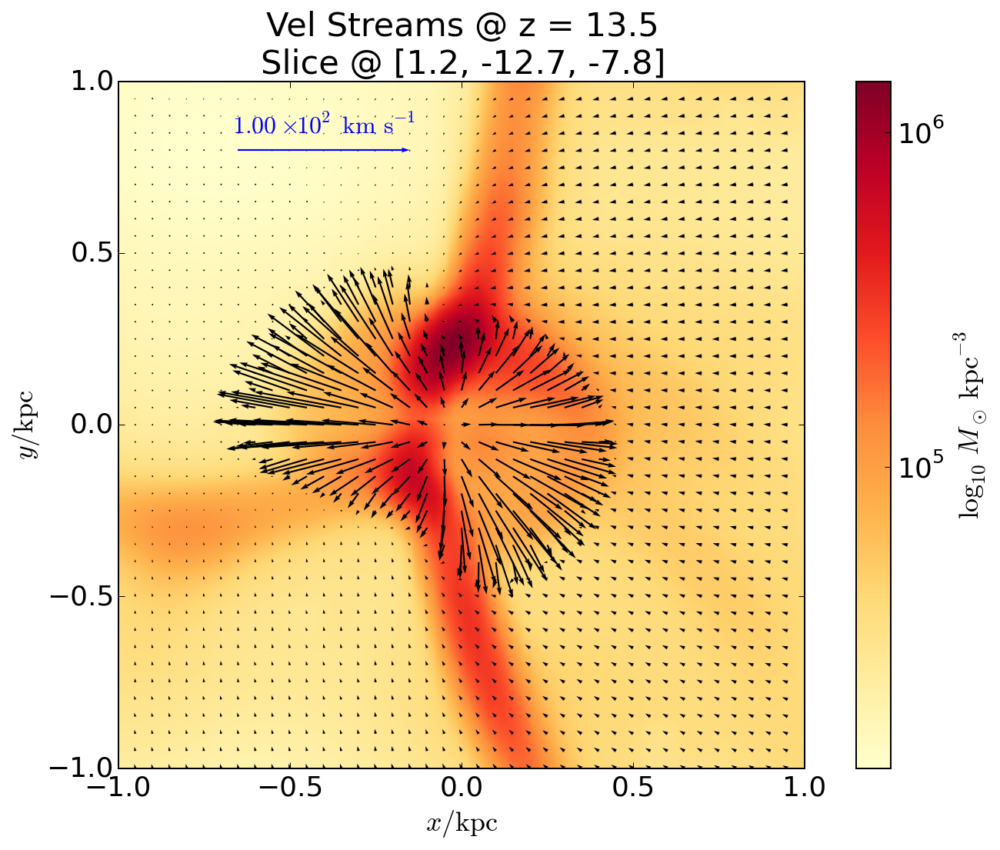

In [58]:
coords2= [1.2,-12.7,-8.0] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
smallbox='2 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z @ z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams @ z = %.1lf" % z + " @ %s" % str(coords)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


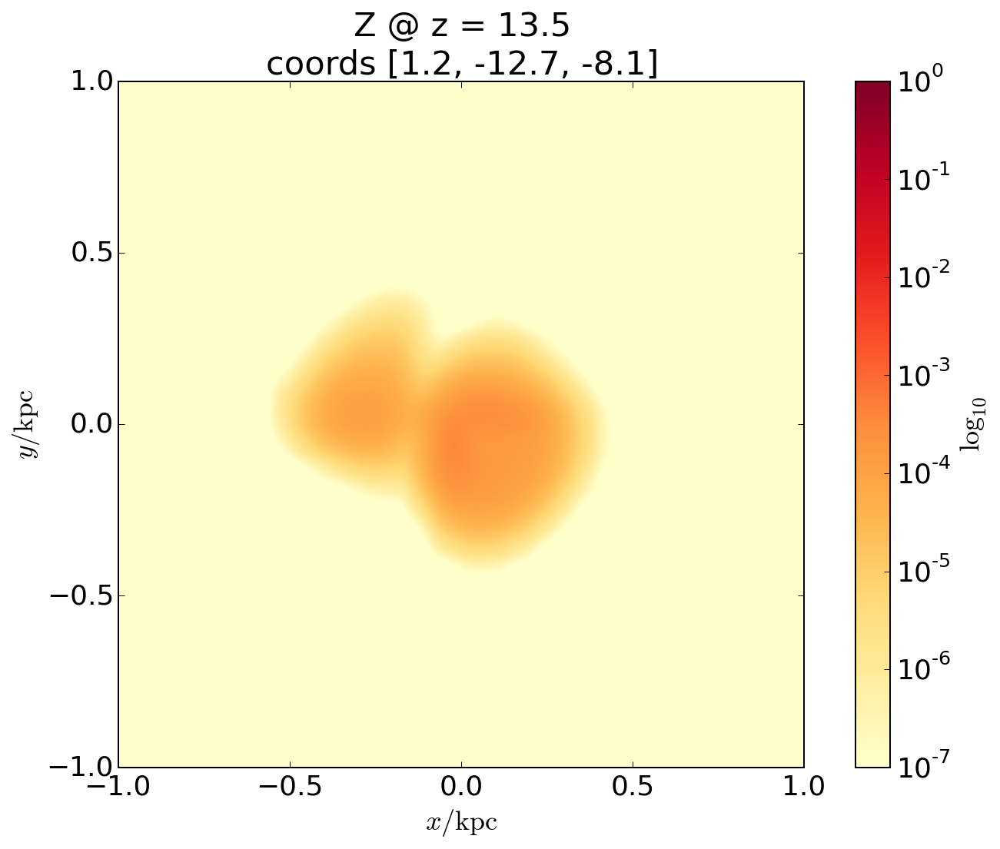

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


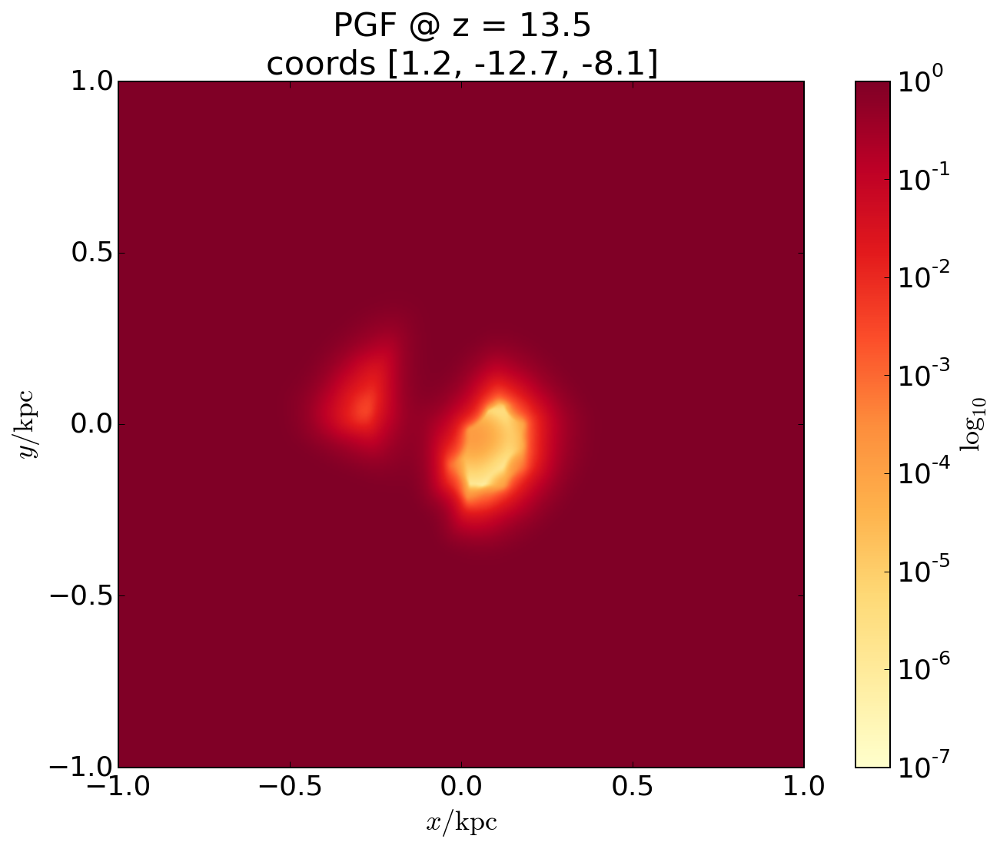

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


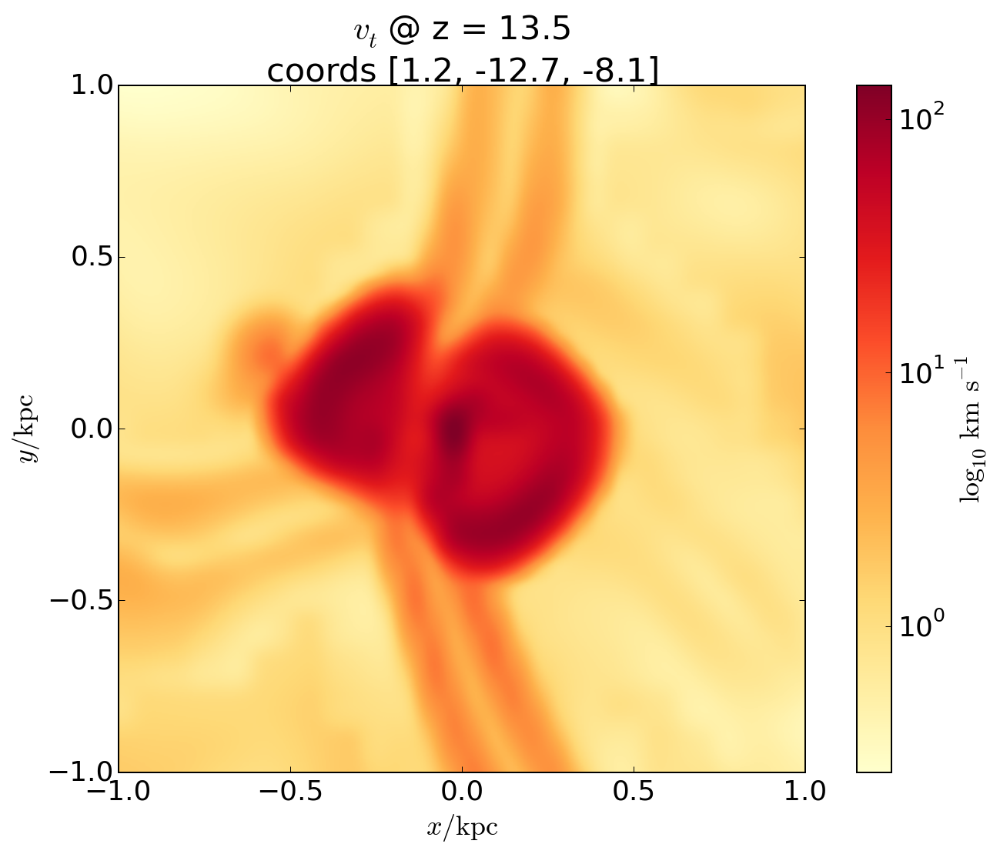

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


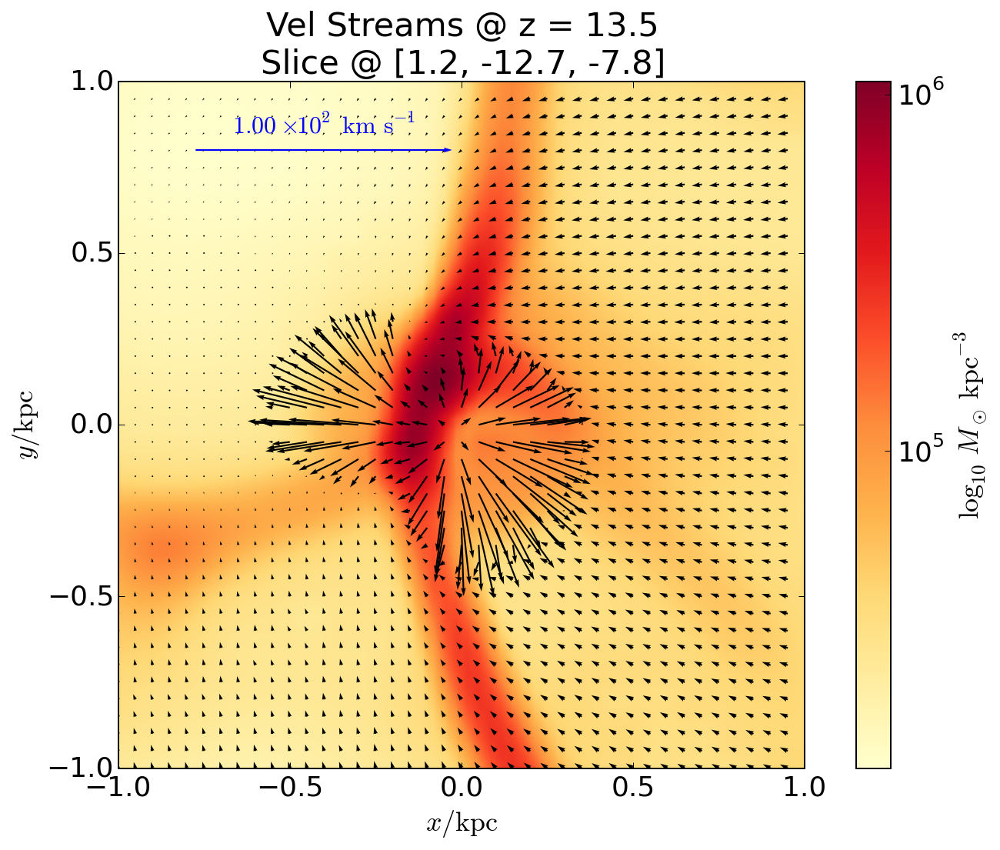

In [59]:
coords2= [1.2,-12.7,-8.1] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
smallbox='2 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z @ z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams @ z = %.1lf" % z + " @ %s" % str(coords)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


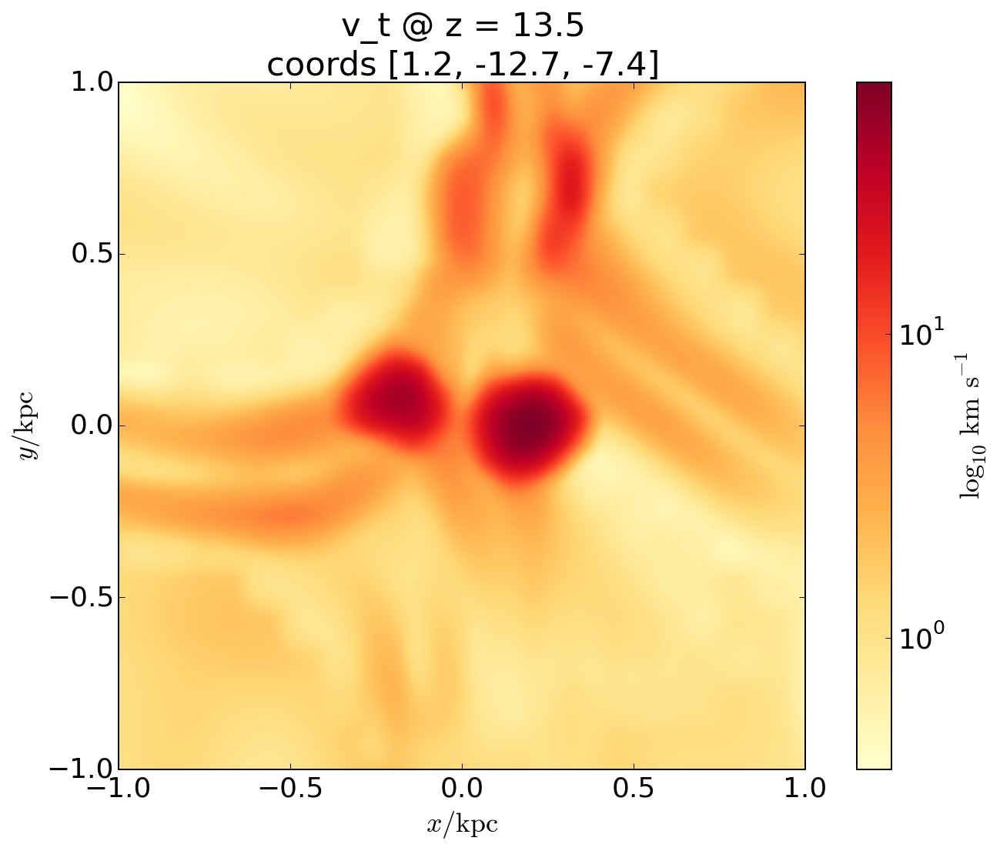

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


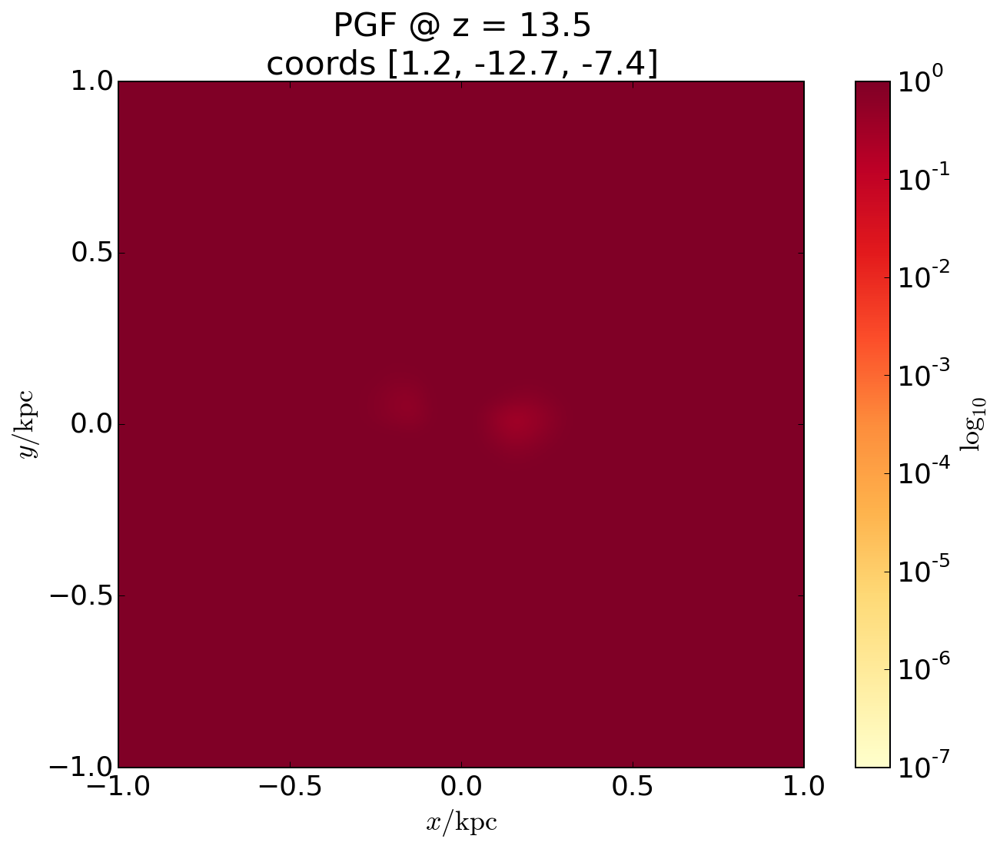

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


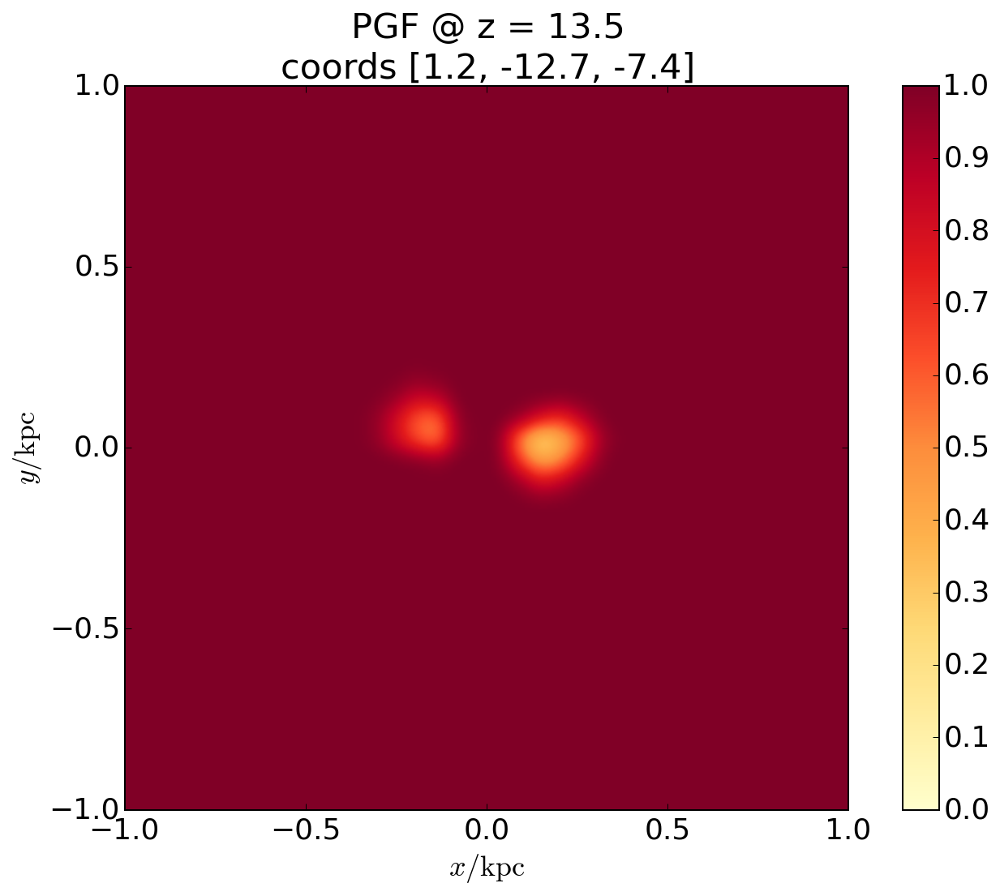

In [61]:
coords2= [1.2,-12.7,-7.4] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "v_t @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,
    plt.show()
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=False, vmin=0,
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,
    plt.show()

In [54]:
gc.collect()

0

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


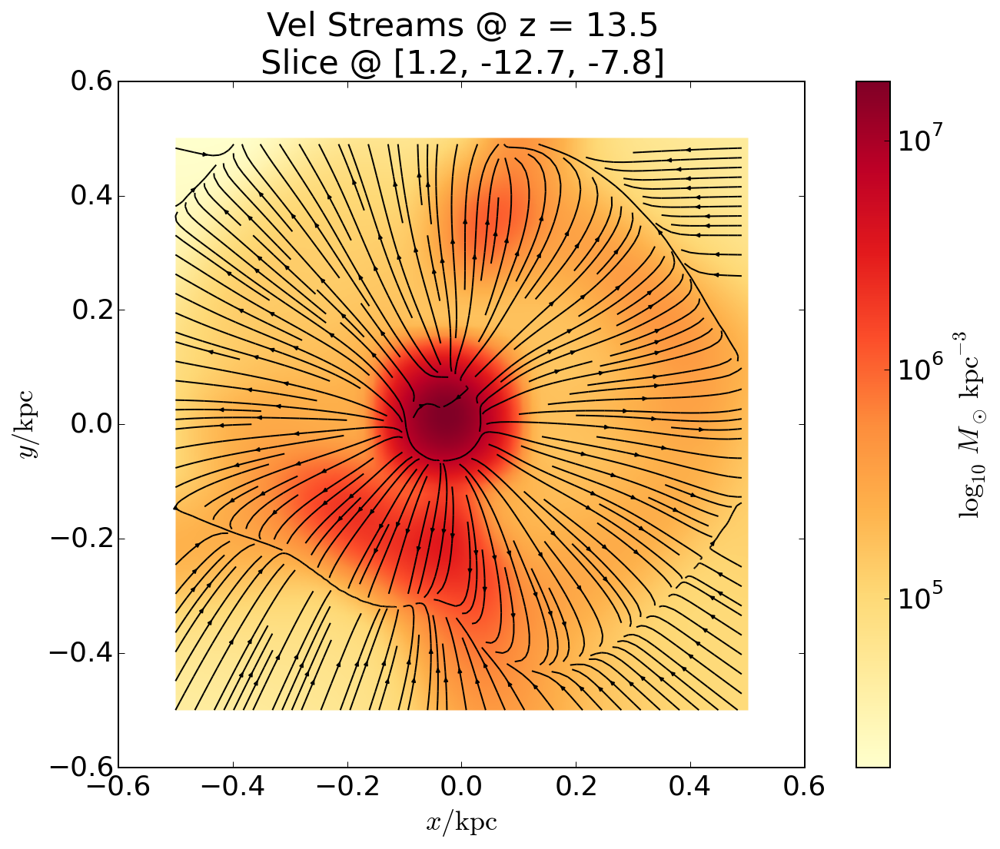

In [30]:
with pynbody.transformation.translate(snBlast,coords):
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(snBlast.g,width="1 kpc",cmap="YlOrRd", mode='stream',
              density=2.0, vector_resolution=100,title=titleStr); #vmin=0.006, vmax=1.0,

#Next output step

In [64]:
s2 = pynbody.load('output_00011')
#s['pos']
s2['pos'] -= 0.5
s2.physical_units();

INFO:pynbody.snapshot:Loading using backend <class 'pynbody.snapshot.ramses.RamsesSnap'>
INFO:pynbody.snapshot.ramses:Loading hydro files
INFO:pynbody.snapshot.ramses:Done
INFO:pynbody.snapshot.ramses:Loading data from CPU 1
INFO:pynbody.snapshot.ramses:Loading data from CPU 33
INFO:pynbody.snapshot.ramses:Loading data from CPU 2
INFO:pynbody.snapshot.ramses:Loading data from CPU 34
INFO:pynbody.snapshot.ramses:Loading data from CPU 3
INFO:pynbody.snapshot.ramses:Loading data from CPU 35
INFO:pynbody.snapshot.ramses:Loading data from CPU 4
INFO:pynbody.snapshot.ramses:Loading data from CPU 36
INFO:pynbody.snapshot.ramses:Loading data from CPU 5
INFO:pynbody.snapshot.ramses:Loading data from CPU 37
INFO:pynbody.snapshot.ramses:Loading data from CPU 6
INFO:pynbody.snapshot.ramses:Loading data from CPU 38
INFO:pynbody.snapshot.ramses:Loading data from CPU 7
INFO:pynbody.snapshot.ramses:Loading data from CPU 39
INFO:pynbody.snapshot.ramses:Loading data from CPU 8
INFO:pynbody.snapshot.rams

In [114]:
gc.collect()

0

In [115]:
s2.g['metal'][s2.g['metal']<1e-7] = 0.0
s2.g['pzf'][s2.g['pzf']<1e-7] = 0.0
s2.g['pgf'][s2.g['pgf']>1.0 - 1e-7] = 1.0
s2.g['pgf'][s2.g['pgf']<0.0] = 0.0

s2.s['metal'][s2.s['metal']<1e-7] = 0.0
s2.s['pzf'][s2.s['pzf']<1e-7] = 0.0
s2.s['ppf'][s2.s['ppf']>1.0 - 1e-7] = 1.0
s2.s['ppf'][s2.s['ppf']<0.0] = 0.0

In [116]:
# Star particle location
s2.s['pos'],len(s2.g)

(SimArray([[ -1.24228009,  12.87064762,   7.88650888]], 'kpc'), 24238673)

In [117]:
s2.properties

{'a': 0.0700191886451787,
 'boxsize': Unit("2.95e+01 kpc"),
 'h': 0.71,
 'omegaL0': 0.732999980449677,
 'omegaM0': 0.266999989748001,
 'time': Unit("3.37e-01 kpc s km**-1")}

In [118]:
z2 = 1/s2.properties['a']-1
print "Redshift =",z2
boxsizestring2 = "%.2f" % s2.properties['boxsize'].in_units('kpc')
boxsizestring2 += " kpc"
print boxsizestring2

Redshift = 13.2817993089
29.53 kpc


In [119]:
snBlast2 = s2[pynbody.filt.Cuboid("-3.2 kpc", "10.7 kpc","5.8 kpc",
                                 "1.75 kpc", "14.7 kpc", "9.9 kpc")]
len(snBlast2)

304024

In [71]:
# Look at points with some velocity -- this is a few steps past the blast.
len(snBlast2.g['tv'][snBlast2.g['tv']>50])

1542

In [51]:
# Save the values in seperate files... Use mathematica to riffle... 
np.savetxt("velDataAfterSN.txt",np.array(snBlast2.g['vel']))
np.savetxt("posDataAfterSN.txt",np.array(snBlast2.g['pos']))

In [72]:
s2.g['velMag']=sqrt(s2.g['vx']**2+s2.g['vy']**2+s2.g['vz']**2)

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


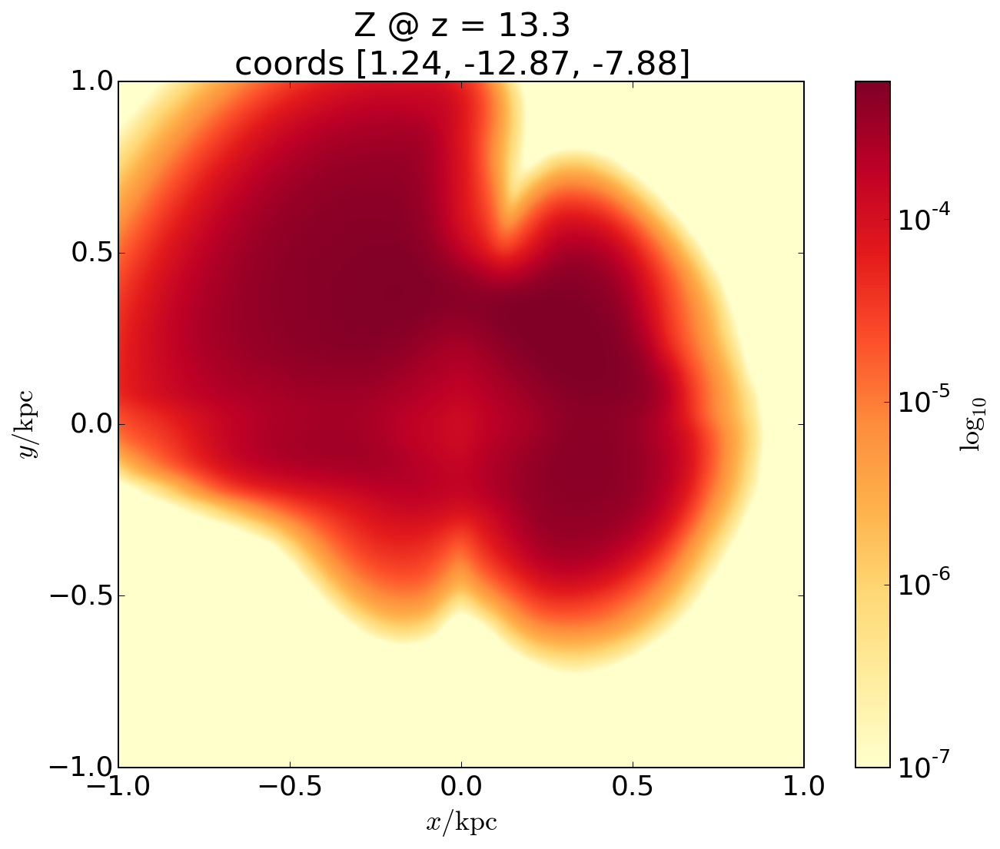

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


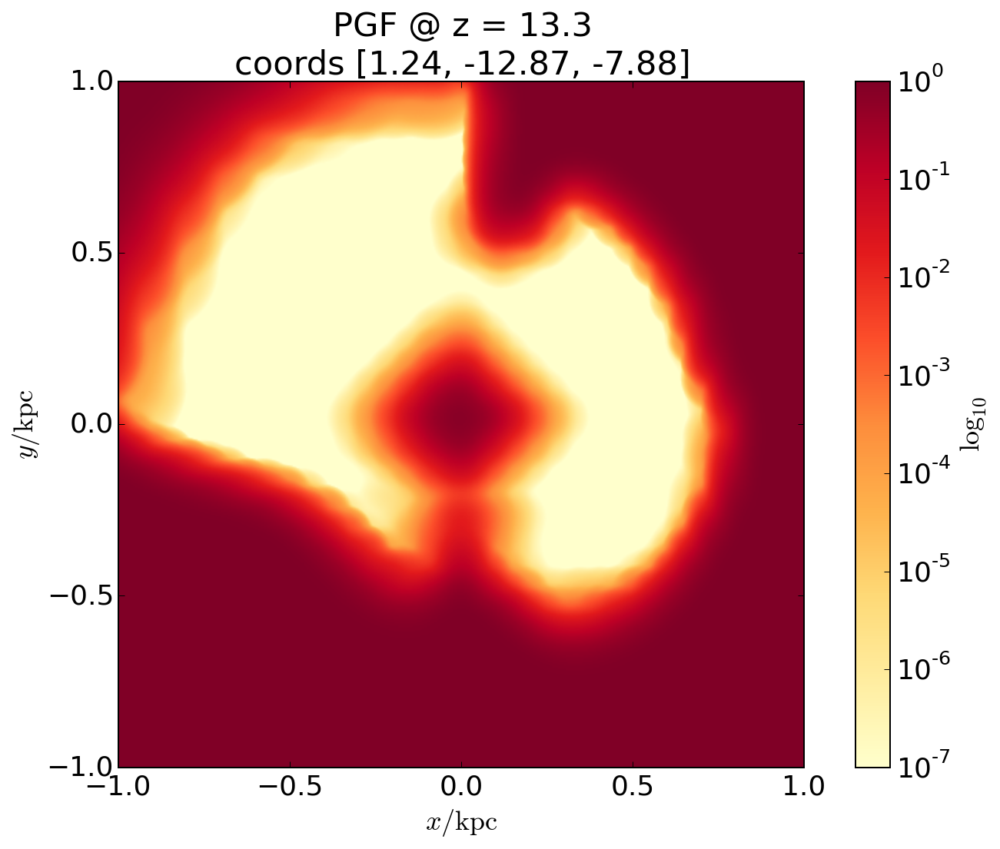

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


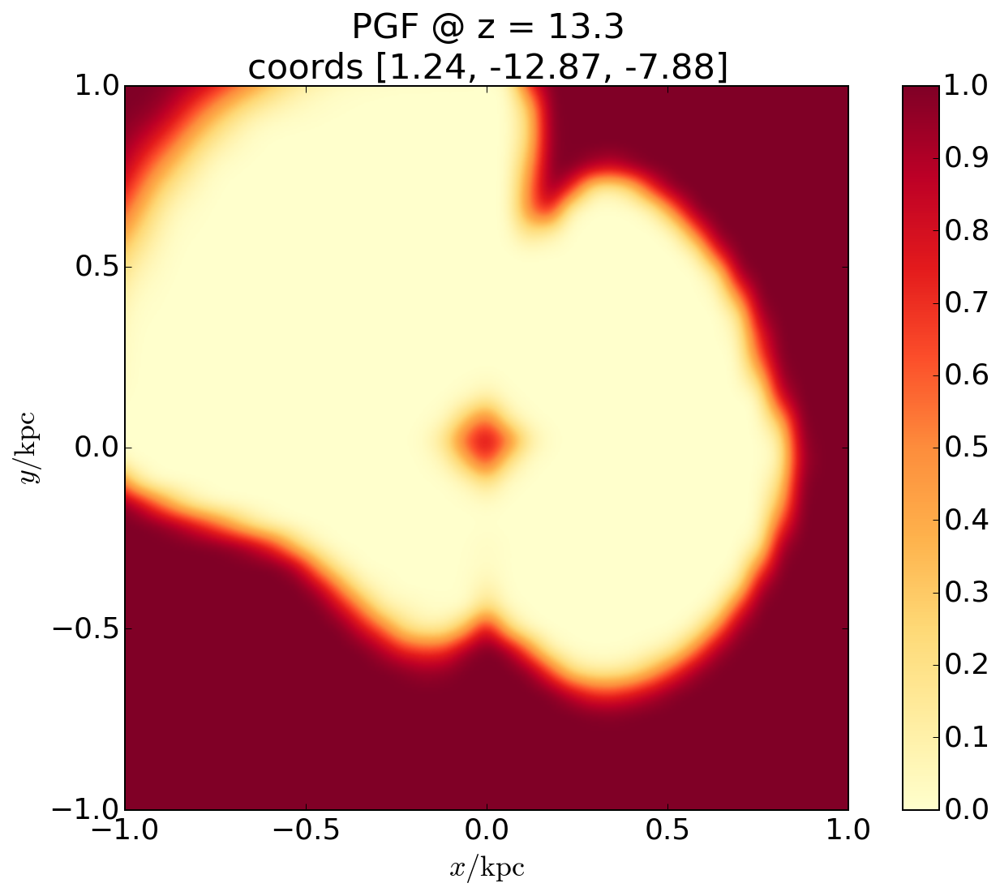

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


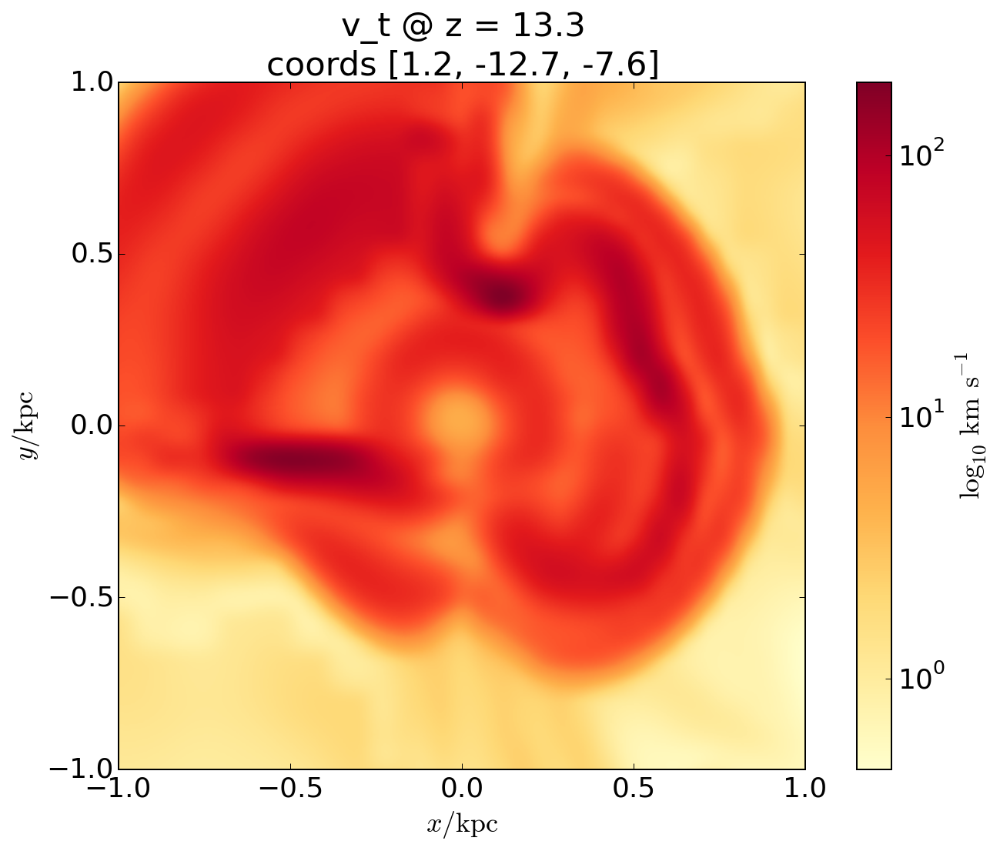

In [121]:
coords22= [1.24,-12.87,-7.88] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
with pynbody.transformation.translate(snBlast2,coords22):
    titleStr = "Z @ z = %.1lf" % z2 + "\ncoords %s"%str(coords22)
    sph.image(snBlast2.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z2 + "\ncoords %s"%str(coords22)
    sph.image(snBlast2.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,
    plt.show()
    sph.image(snBlast2.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=False, vmin=0,
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "v_t @ z = %.1lf" % z2 + "\ncoords %s"%str(coords2)
    sph.image(snBlast2.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.snapshot:Deriving array mass
INFO:pynbody.sph:Rendering image on 32 threads...


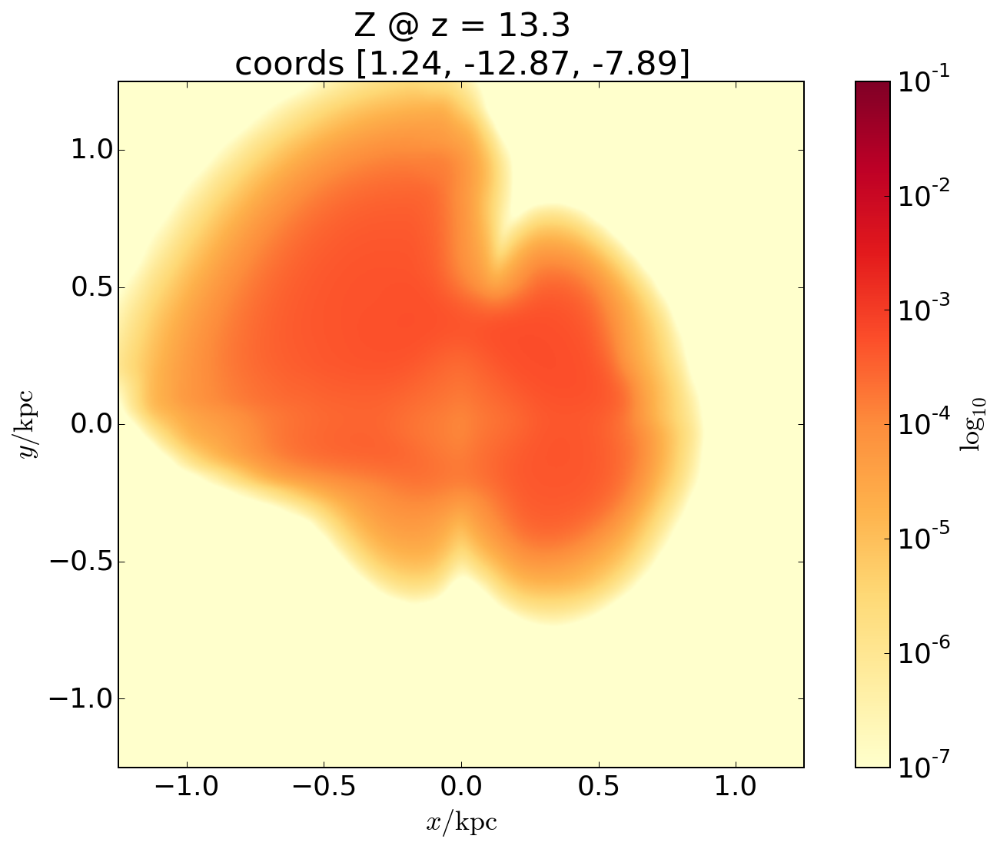

In [53]:
coords= [1.24,-12.87,-7.89] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
smallbox='2.5 kpc'
with pynbody.transformation.translate(snBlast2,coords):
    titleStr = "Z @ z = %.1lf" % z2+ "\ncoords %s"%coords
    sph.image(snBlast2.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7, vmax=1e-1,
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


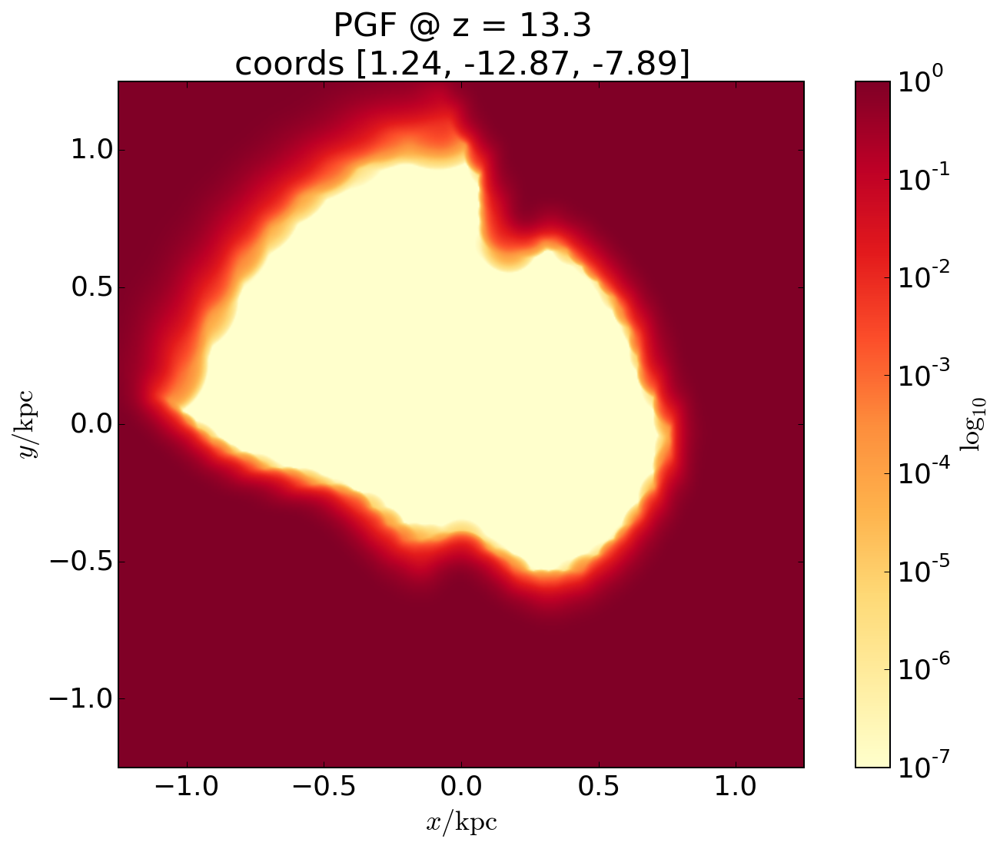

In [56]:
with pynbody.transformation.translate(snBlast2,coords):
    titleStr = "PGF @ z = %.1lf" % z2 + "\ncoords %s"%coords
    sph.image(snBlast2.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


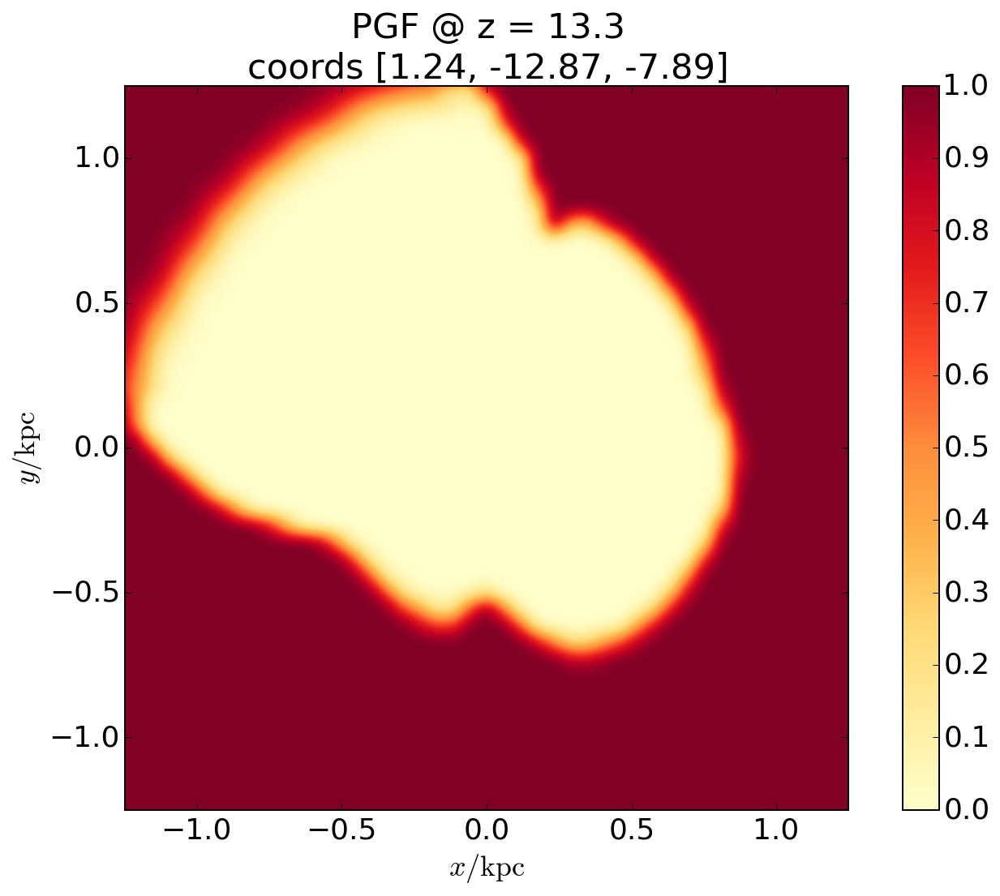

In [55]:
with pynbody.transformation.translate(snBlast2,coords):
    titleStr = "PGF @ z = %.1lf" % z2 + "\ncoords %s"%coords
    sph.image(snBlast2.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=False, 
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


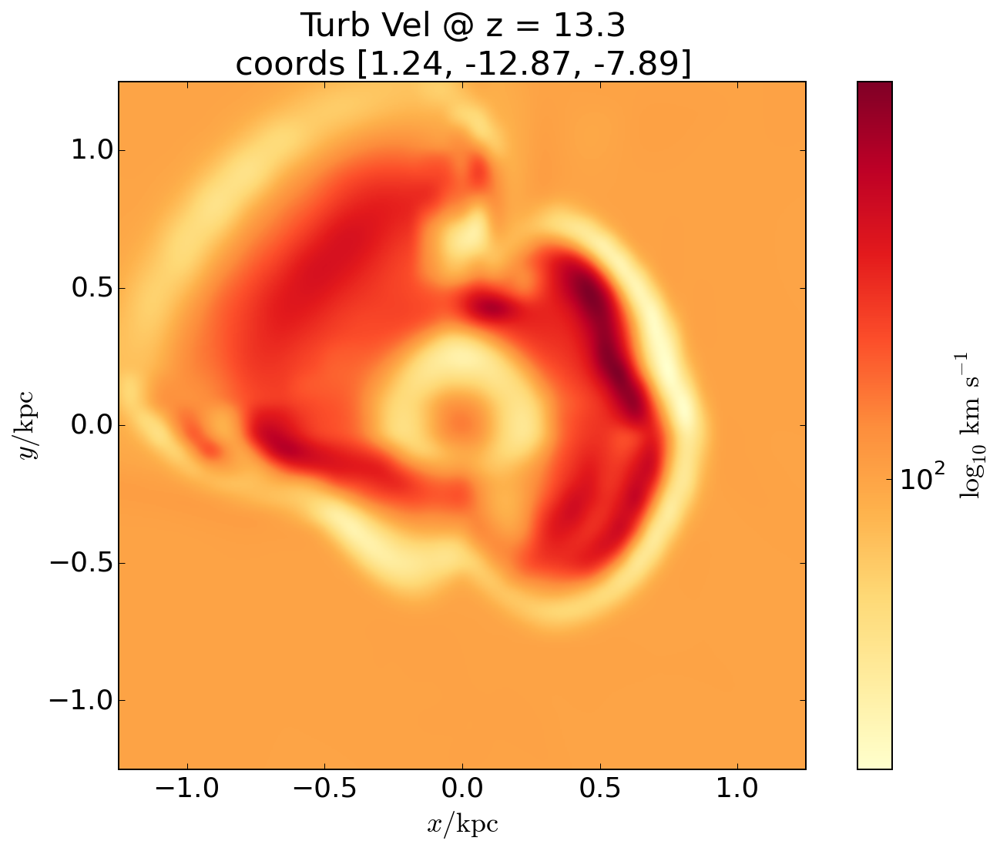

In [59]:
with pynbody.transformation.translate(snBlast2,coords):
    titleStr = "Turb Vel @ z = %.1lf" % z2 + "\ncoords %s"%coords
    sph.image(snBlast2.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


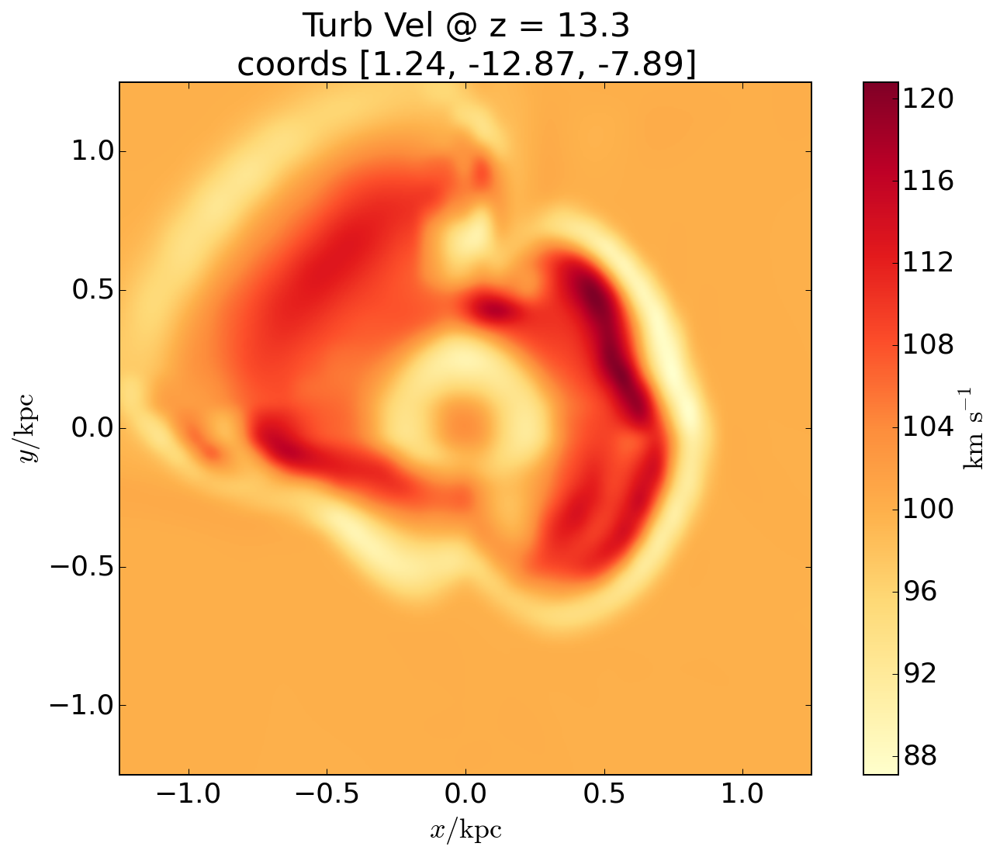

In [60]:
with pynbody.transformation.translate(snBlast2,coords):
    titleStr = "Turb Vel @ z = %.1lf" % z2 + "\ncoords %s"%coords
    sph.image(snBlast2.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=False, 
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.snapshot:Deriving array vr
INFO:pynbody.snapshot:Deriving array r
INFO:pynbody.sph:Rendering image on 32 threads...


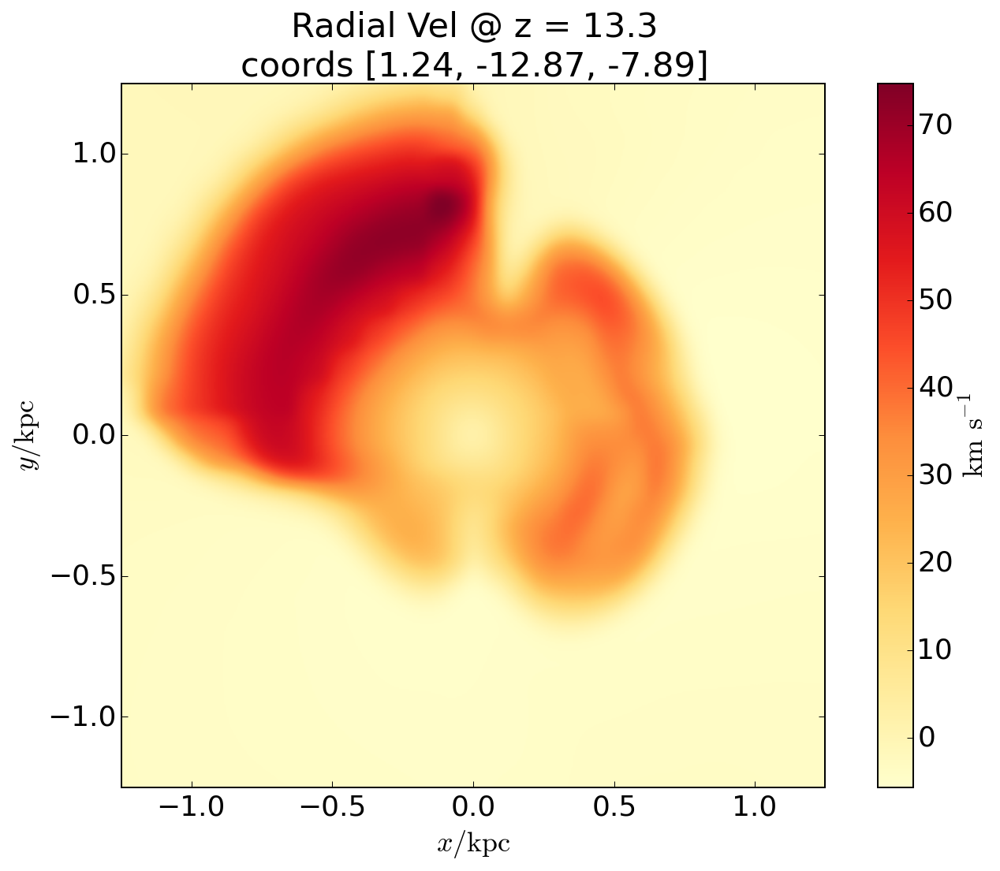

In [62]:
with pynbody.transformation.translate(snBlast2,coords):
    titleStr = "Radial Vel @ z = %.1lf" % z2 + "\ncoords %s"%coords
    sph.image(snBlast2.g,qty="vr",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=False, 
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


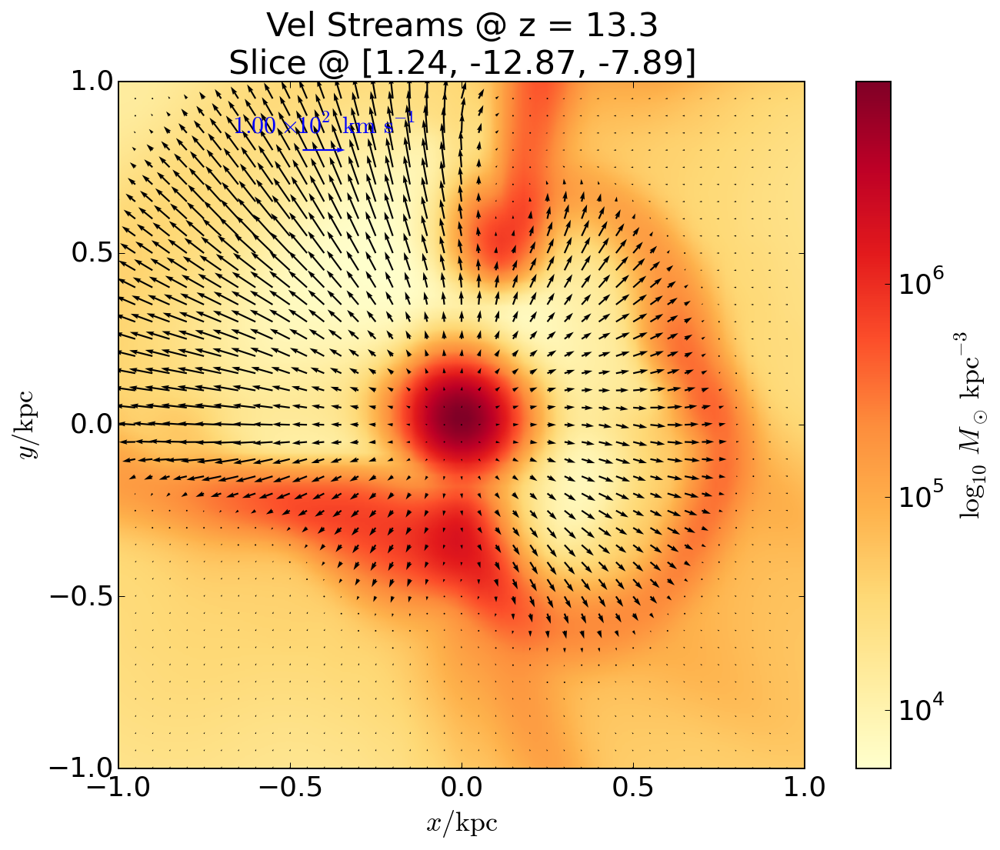

In [74]:
coords= [1.24,-12.87,-7.89] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
with pynbody.transformation.translate(snBlast2,coords):
    titleStr = "Vel Streams @ z = %.1lf" % z2 + "\nSlice @ %s" % str(coords)
    sph.velocity_image(snBlast2.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.snapshot:Deriving array vt
INFO:pynbody.snapshot:Deriving array vr
INFO:pynbody.snapshot:Deriving array r
INFO:pynbody.sph:Rendering image on 32 threads...


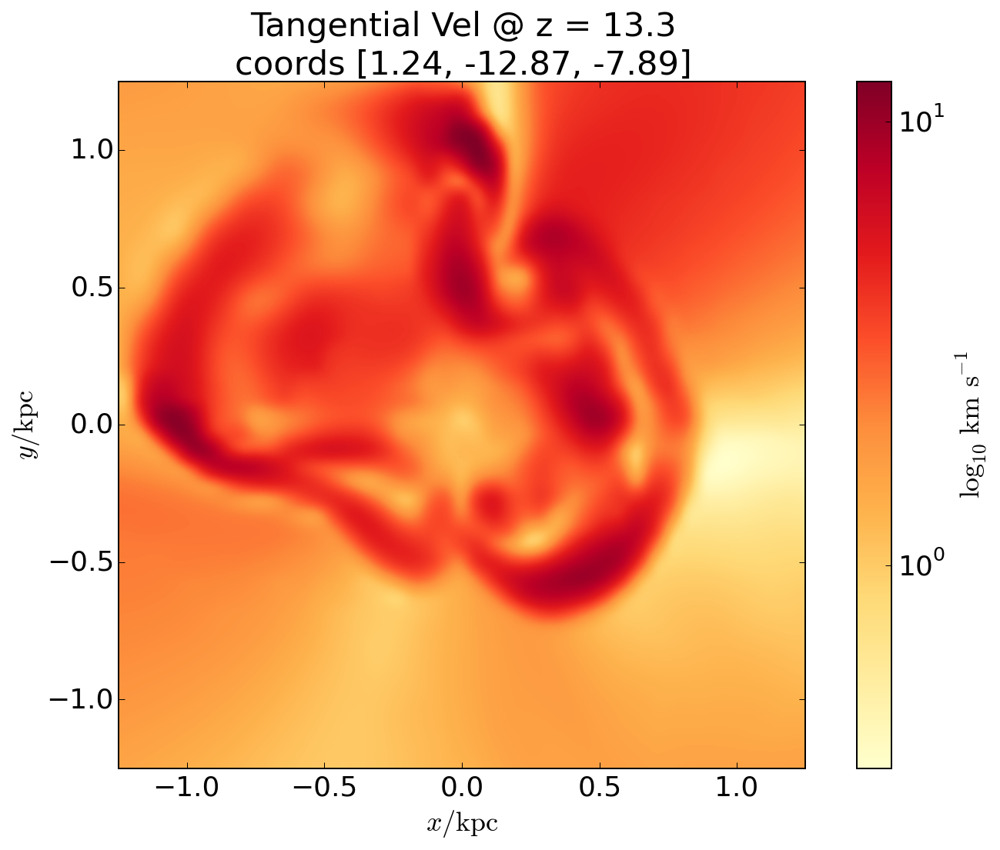

In [127]:
# Star particle centered tangent vel
with pynbody.transformation.translate(snBlast2,coords):
    titleStr = "Tangential Vel @ z = %.1lf" % z2 + "\ncoords %s"%coords
    sph.image(snBlast2.g,qty="vt",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,